In [1]:
from keyscaping import *
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from matplotlib.lines import Line2D
import seaborn as sns
import pandas as pd
sns.set()
from PIL import Image

/usr/local/lib/python3.7/site-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/usr/local/lib/python3.7/site-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit


In [14]:
#report_fig_folder_path = '../report/5e1f16ed63eefd00018d886b/Figures/'
report_fig_folder_path = '../report/5e36b1c6d8be3e00010ada28/Figures/'
intro_folder = report_fig_folder_path + 'introduction/'
methodology_folder = report_fig_folder_path + 'methodology/'
casestudy_folder = report_fig_folder_path + 'casestudy/'
bonus_folder = report_fig_folder_path + 'bonus/'
tmp_png = 'tmpPNG/'

presentation_folder = 'presentationFigs/'

midi_files_folder = '../midiFiles/'
audio_files_folder = '../audioFiles/'
small_resolution = 250
middle_resolution = 500
big_resolution = 1000
very_big_resolution = 2000

uniform_plot_size = (24, 13)

bach_prelude = '210606-Prelude_No._1_BWV_846_in_C_Major.mid'
webern_variations = 'Webern_Variationen_fur_Klavier_1.mid'
fs_ro1 = 'SymphonyROI1.mid'
fs_ro2 = 'SymphonyROI2.mid'
pale ='palestrina.mid'
giant_steps_midi = 'giant-steps-wout-drums-first-chorus.mid'
giant_steps_wav = 'giant-steps-coltrane-first-chorus.wav'
faust_symphony_midi = 'faust_symphony1.mid'
faust_symphony_wav = 'Faust_symphony1.wav'

### Tools Function

In [3]:
def wavescape_out_of_pc_vector(pcv_array, resolution, coeff, draw_indicators = True, draw_line = False):
    utm = generalized_keyscape(pcv_array, lambda v : color_mapping_phase_and_magnitude_with_opacity(v, coeff))
    ks = Keyscape(utm, resolution)
    ks.generate_diamonds()
    return ks.draw(plot_indicators = draw_indicators, add_line = draw_line)

def saveToJpeg(svgDrawing, filename, output_folder):
    output_filename = tmp_png + filename + '.png'
    svgDrawing.savePng(output_filename)
    im = Image.open(output_filename)
    rgb_im = im.convert('RGB')
    rgb_im.save(output_folder + filename + '.jpg')
    
def pltSaveToJpeg(filename, output_folder):
    output_filename = tmp_png + filename + '.png'
    plt.savefig(output_filename)
    im = Image.open(output_filename)
    rgb_im = im.convert('RGB')
    rgb_im.save(output_folder + filename + '.jpg')

def pcv_from_filepath(filepath, resolution):
    if filepath.endswith('.mid'):
        pol = produce_pitch_offset_list_from_midi_filename(filepath)
        return pitch_class_set_vector_from_pitch_offset_list(pol)
    elif filepath.endswith('.wav'):
        return produce_chromagrams_from_audio_file(filepath, resolution/2 - 2)    
    else:
        raise Exception("File entered is neither of midi or wav format")

def extract_filename(filepath):
    filename = filepath.split('/')[-1]
    return filename.split('.')[0] #to remove the .mid or .wav at the end
    
def wavescape_all_coeffs(filepath, resolution, output_folder = None):
    pcs_array = pcv_from_filepath(filepath, resolution)
    filename = extract_filename(filepath)
    
    name_ks_dict = {}
    for i in range(1,7):
        name_ks_dict[filename+'_%dc'%i] = wavescape_out_of_pc_vector(pcs_array, resolution, i)
        
    if output_folder:
        for k, v in name_ks_dict.items():
            saveToJpeg(v, k, output_folder)
    else:
        return name_ks_dict

def wavescape_one_coeff(filepath, resolution, coeff, output_folder = False, \
                        draw_indicators = True, draw_line = False):
    pcs_array = pcv_from_filepath(filepath, resolution)
    ws = wavescape_out_of_pc_vector(pcs_array, resolution, coeff, draw_indicators, draw_line)
        
    if output_folder:        
        filename = extract_filename(filepath)
        saveToJpeg(ws, filename + '_%dc'%coeff, output_folder)
    else:
        return ws
    
def keyscape_from_filename(filepath, resolution, output_folder = None):
    ks_utm = produce_ks_as_utm_format_from_pitch_offset_list(produce_pitch_offset_list_from_midi_filename(filepath))
    ks, _ = generate_keyscape_from_ks_utm(ks_utm, resolution)
    if output_folder:
        filename = extract_filename(filepath)
        saveToJpeg(ks, filename, output_folder)
    else:
        return ks

def convertTempPngToTif(filename, output_folder):
    output_filename = tmp_png + filename + '.png'
    im = Image.open(output_filename)
    rgb_im = im.convert('RGB')
    rgb_im.save(output_folder + filename + '.jpg')
    
def coeff_to_label(coeff):
    coeff_str = ''
    if coeff == 1:
        coeff_str = '1st'
    elif coeff == 2:
        coeff_str = '2nd'
    elif coeff == 3:
        coeff_str = '3rd'
    else:
        coeff_str = '%dth'%coeff
    return coeff_str

def add_label_top_left_corner_of_canvas(canvas, label, plot_size):
    text_size = 0.65*(plot_size/10) # we want the text to be displayed on one tenth of the plot's size
    x_spot = -2*(plot_size)/5.
    y_spot = -x_spot
    canvas.append(draw.Text(label, text_size, x_spot, y_spot, fill='black'))
    return canvas
    
def six_wavescapes_collage(filename, ws_resolution, output_filepath, file_format='.png'):
    get_coeff_nmbr = lambda k: k.split('_')[-1].replace('c','')
    label_ws_dict = wavescape_all_coeffs(filename, ws_resolution)
    for k, v in label_ws_dict.items():
        coeff_label = coeff_to_label(int(get_coeff_nmbr(k))) + ' coef.'
        add_label_top_left_corner_of_canvas(v, coeff_label, ws_resolution).savePng(tmp_png+k+'.png')
        
    total_width = ws_resolution * 3
    total_height = ws_resolution * 2
    
    nmbr_ws_dict = {int(get_coeff_nmbr(k)):Image.open(tmp_png+k+'.png').convert('RGB')\
            for k,_ in label_ws_dict.items()} 
    
    canvas = Image.new('RGB', (total_width, total_height), (0xff, 0xff,0xff))
    #top row (1c, 2c, 3c)
    for i in range(3):
        curr_ws = nmbr_ws_dict[i+1]
        canvas.paste(curr_ws, (ws_resolution*i, 0))
    #bottom row (1c, 2c, 3c)
    for j in range(3,6):
        curr_ws = nmbr_ws_dict[j+1]
        canvas.paste(curr_ws, (ws_resolution*(j-3), ws_resolution))
        
    canvas.save(output_filepath+file_format)
    return canvas

def midi_vs_wav_wavescapes_collage(midi_filepath, wav_filepath, resolution, coeff, \
                               output_filepath, horizontal_orientation = True):
    
    midi_ws = wavescape_one_coeff(midi_filepath, resolution, coeff)
    wav_ws = wavescape_one_coeff(wav_filepath, resolution, coeff)
    midi_fp = tmp_png+'tmpMidi.png'
    wav_fp = tmp_png+'tmpWav.png'
    midi_ws.savePng(midi_fp)
    wav_ws.savePng(wav_fp)
    
    midi_im = Image.open(midi_fp).convert('RGB')
    wav_im = Image.open(wav_fp).convert('RGB')
    
    offset = int(resolution+resolution/10)
    
    coords = (resolution + offset, resolution)
    total_width = int(coords[(0 if horizontal_orientation else 1)])
    total_height = int(coords[(1 if horizontal_orientation else 0)])
 
    midi_position = (0, 0)
    wav_position = (offset, 0) if horizontal_orientation else (0, offset)
    canvas = Image.new('RGB', (total_width, total_height), (0xff, 0xff,0xff))
    canvas.paste(midi_im, midi_position)
    canvas.paste(wav_im, wav_position)
        
    canvas.save(output_filepath+'.jpg')
    return canvas

### Introduction Plots

#### Temperley Template Matching on Bach's Prelude in C Major (BW 846)

In [4]:
saveToJpeg(keyscape_from_filename(midi_files_folder+bach_prelude, very_big_resolution), 'BachPreludeCMajorTemperleyMatching', intro_folder)

####  Temperley Template Matching on Faust Symphony 

In [5]:
saveToJpeg(keyscape_from_filename(midi_files_folder+faust_symphony_midi, very_big_resolution), 'FaustSymphonyTemperleyMatching', intro_folder)

#### Print (Very High resolution) legend for the keyscapes

In [6]:
def build_lof_dict(labels, profile, is_major):
    assert(len(labels) == 12)
    res_dict = {}
    for i in range(12):
        idx = (7*i) % 12
        vector = np.roll(profile, idx)
        res_dict[labels[idx]] = circular_hue(nth_coeff_phase(vector, 5), opacity= 0xff if is_major else 0x77)
    if not is_major:
        l = list(res_dict.items())
        res_dict = {k:v for k, v in (l[3:] + l[:3])}
    return res_dict



maj_temperley_lof = build_lof_dict(twelve_tones_major_key_names, temperley_maj, True)
min_temperley_lof = build_lof_dict(twelve_tones_minor_key_names, temperley_min, False)
res = display_key_colors(maj_temperley_lof, min_temperley_lof, total_width=very_big_resolution)
saveToJpeg(res, 'TemperleyMatchingLegend', intro_folder)

#### Conversion of the Faust Symphony Score

In [ ]:
convertTempPngToTif(filename, output_folder)

### Methodology Plots

### Heatmap of the normalized magnitude of different musical structure

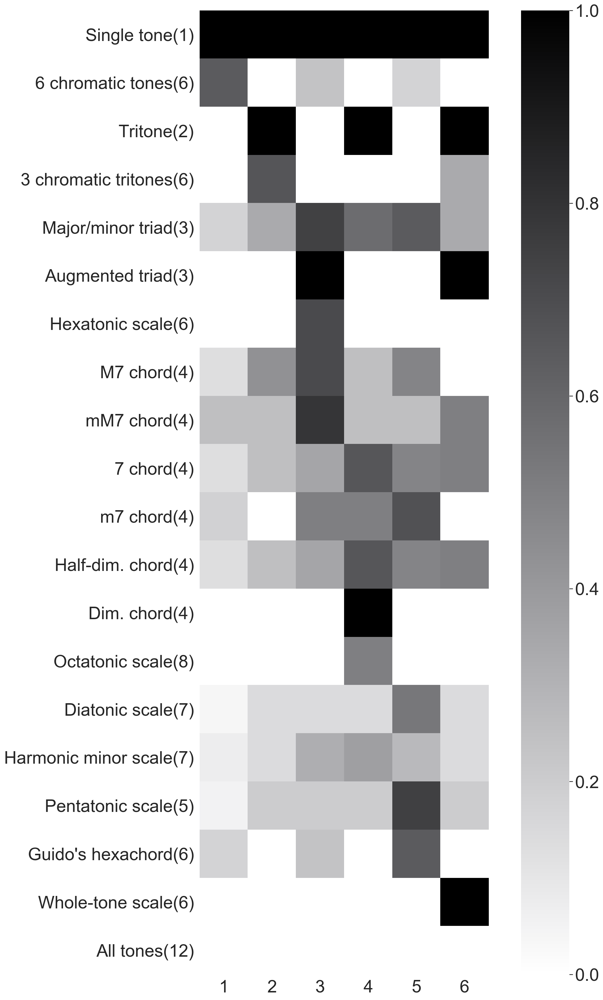

In [3]:
total_dict = {
    'Single tone (1)' : [1,0,0,0,0,0,0,0,0,0,0,0],
    'Tritone (2)' : [1,0,0,0,0,0,1,0,0,0,0,0],
    'Major/minor triad (3)' : [1,0,0,1,0,0,0,1,0,0,0,0],
    'Augmented triad (3)':   [1,0,0,0,1,0,0,0,1,0,0,0],
    'M7 chord (4)' : [1,0,0,0,1,0,0,1,0,0,0,1],
    'm7 chord (4)' : [1,0,0,1,0,0,0,1,0,0,1,0],
    'dom/half-dim. chord (4)' :  [1,0,0,0,1,0,0,1,0,0,1,0],
    'Dim. chord (4)': [1,0,0,1,0,0,1,0,0,1,0,0],
    'Pentatonic scale (5)': [1,0,1,0,1,0,0,1,0,1,0,0],
    'Guido\'s hexachord (6)' :[1,0,1,0,1,1,0,1,0,1,0,0],
    'Whole-tone scale (6)' : [1,0,1,0,1,0,1,0,1,0,1,0],
    '6 chromatic tones (6)': [1,1,1,1,0,0,0,0,0,0,1,1],
    'Diatonic scale (7)': [1,0,1,0,1,1,0,1,0,1,0,1],
    '3 chromatic tritones (6)' : [1,1,0,0,0,1,1,1,0,0,0,1],
    'Hexatonic scale (6)': [1,1,0,0,1,1,0,0,1,1,0,0],
    'Octatonic scale (8)': [1,1,0,1,1,0,1,1,0,1,1,0],
    'All tones (12)': [1,1,1,1,1,1,1,1,1,1,1,1]
}

coeffs_1_to_6 = {str(i):i for i in range(1,7)}


def heatmap_plotting(labels_in_vec_dict, coeffs_dict, normalization=True, figsize = (16, 24), epsilon=.0001):
    labelsize= 20
    plt.figure(figsize=figsize)
    mpl.rc('xtick', labelsize=labelsize) 
    mpl.rc('ytick', labelsize=labelsize)
    
    labels = list(labels_in_vec_dict.keys())
    vectors = list(labels_in_vec_dict.values())
    coeffs = list(coeffs_dict.values())
    x_len = len(labels)
    y_len = len(coeffs)
    matrice = np.full((x_len, y_len), 0.0, np.float32)
    for i in range(x_len):
        for j in range(y_len):
            vec = vectors[i]
            coeff = coeffs[j]
            norm_magn = nth_coeff_magn(vec, coeff)/(sum(vec) if normalization else 1.0)
            norm_magn = norm_magn if norm_magn > epsilon else 0.
            matrice[i][j] = norm_magn

    cmap = sns.cubehelix_palette(50, hue=0.05, rot=0, light=1, dark=0, as_cmap=True)
    ax = sns.heatmap(matrice, yticklabels=labels, xticklabels=list(coeffs_dict.keys()), square=True, cmap=cmap, annot=True, annot_kws={"size": labelsize})
    ax.xaxis.tick_top()
    ax.xaxis.set_label_position('top')
    plt.xlabel('k', fontsize=labelsize)
    return ax

heatmap_plotting(total_dict, coeffs_1_to_6)
plt.tight_layout()

#### The toolset for pitch class vector visualisation

In [5]:
list_selector = lambda ls, sel: list([ls[i] for i in sel])

def nth_coeff_magn_and_phase(input_vec, n_coeff):
    assert(n_coeff <= len(input_vec))
    dft_nth_coeff = np.fft.fft(input_vec)[n_coeff]
    return (np.abs(dft_nth_coeff), np.angle(dft_nth_coeff))

def bw_keys_x_axis(is_for_fourier=False, diatonic_label=True, scaling_factor =1, plot_w=20, plot_h=10, alpha=1.):

    key_nmb = 12
    
    fig, ax = plt.subplots(figsize=(plot_w, plot_h))
    if is_for_fourier:
        ax.set(ylim=[-1.2, 1.2])
    
    bar_w = 1*.8
    CDE_idx = [0,2,4]
    FGAB_idx = [5,7,9,11]
    DbEb_idx = [1,3]
    GbAbBb_idx = [6,8,10]
    white = [1.,1.,1.,alpha] 
    black = [0.,0.,0.,alpha]
    
    CDE_vals = [scaling_factor]*len(CDE_idx)
    FGAB_vals = [scaling_factor]*len(FGAB_idx)
    DbEb_vals = [scaling_factor]*len(DbEb_idx)
    GbAbBb_vals = [scaling_factor]*len(GbAbBb_idx)
    
    matplotlib.rc('xtick', labelsize=27) 
    matplotlib.rc('ytick', labelsize=27) 
    
    if is_for_fourier:
        ax.bar(CDE_idx, CDE_vals, bar_w, align='center', color=white, linewidth=1, edgecolor='none')
        ax.bar(FGAB_idx, FGAB_vals, bar_w, align='center', color=white, linewidth=1, edgecolor='none')
        ax.bar(DbEb_idx, DbEb_vals, bar_w, align='center', color=black, linewidth=1, edgecolor='none')
        ax.bar(GbAbBb_idx, GbAbBb_vals, bar_w, align='center', color=black, linewidth=1, edgecolor='none')
        
        ax.bar(CDE_idx, np.negative(CDE_vals), bar_w, align='center', color=white, linewidth=1, edgecolor='none')
        ax.bar(FGAB_idx, np.negative(FGAB_vals), bar_w, align='center', color=white, linewidth=1, edgecolor='none')
        ax.bar(DbEb_idx, np.negative(DbEb_vals), bar_w, align='center', color=black, linewidth=1, edgecolor='none')
        ax.bar(GbAbBb_idx, np.negative(GbAbBb_vals), bar_w, align='center', color=black, linewidth=1, edgecolor='none')
    else:
        ax.bar(CDE_idx, CDE_vals, bar_w, align='center', color=white, linewidth=1, edgecolor=[black]*len(CDE_idx))
        ax.bar(FGAB_idx, FGAB_vals, bar_w, align='center', color=white, linewidth=1, edgecolor=[black]*len(FGAB_idx))
        ax.bar(DbEb_idx, DbEb_vals, bar_w, align='center', color=black, linewidth=1, edgecolor=[black]*len(DbEb_idx))
        ax.bar(GbAbBb_idx, GbAbBb_vals, bar_w, align='center', color=black, linewidth=1, edgecolor=[black]*len(GbAbBb_idx))
    
    if diatonic_label: 
        pitch_names = ['C', 'D', 'E', 'F', 'G', 'A', 'B']
        ax.set_xticks(list(CDE_idx)+list(FGAB_idx))
        ax.set_xticklabels(pitch_names)
    else:
        pitch_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'Bb', 'B']
        ax.set_xticks(range(12))
        ax.set_xticklabels(pitch_names)
    plt.grid(b=False)
        
    fig.tight_layout()
    
def keyboard_visu(pcd, is_for_fourier=False, plot_negative=False, diatonic_label=True, plot_w=20, plot_h=10):

    key_nmb = 12
    bar_w = 1
    
    fig, ax = plt.subplots(figsize=(plot_w, plot_h))
    if is_for_fourier:
        #normalizing the array
        pcd /= np.max(np.abs(pcd), axis=0)
        ax.set(ylim=[-1.2, 1.2])
        
    CDE_idx = [0,2,4]
    FGAB_idx = [5,7,9,11]
    DbEb_idx = [1,3]
    GbAbBb_idx = [6,8,10]

    white = [1.,1.,1.,1.] 
    black = [0.,0.,0.,1.]
    
    CDE_vals = list_selector(pcd, CDE_idx)
    FGAB_vals = list_selector(pcd, FGAB_idx)
    DbEb_vals = list_selector(pcd, DbEb_idx)
    GbAbBb_vals = list_selector(pcd, GbAbBb_idx)
    
    matplotlib.rc('xtick', labelsize=27)
    matplotlib.rc('ytick', labelsize=27)
    
    ax.bar(CDE_idx, CDE_vals, bar_w, align='edge', color=white, linewidth=1, edgecolor=[black]*len(CDE_idx))
    ax.bar(FGAB_idx, FGAB_vals, bar_w, align='edge', color=white, linewidth=1, edgecolor=[black]*len(FGAB_idx))
    ax.bar(DbEb_idx, DbEb_vals, bar_w, align='edge', color=black, linewidth=1, edgecolor=[black]*len(DbEb_idx))
    ax.bar(GbAbBb_idx, GbAbBb_vals, bar_w, align='edge', color=black, linewidth=1, edgecolor=[black]*len(GbAbBb_idx))
    
    if plot_negative:
        white[3] = .5
        black[3] = .5
        ax.bar(CDE_idx, np.negative(CDE_vals), bar_w, align='edge', color=white, linewidth=1, edgecolor=[black]*len(CDE_idx))
        ax.bar(FGAB_idx, np.negative(FGAB_vals), bar_w, align='edge', color=white, linewidth=1, edgecolor=[black]*len(FGAB_idx))
        ax.bar(DbEb_idx, np.negative(DbEb_vals), bar_w, align='edge', color=black, linewidth=1, edgecolor=[black]*len(DbEb_idx))
        ax.bar(GbAbBb_idx, np.negative(GbAbBb_vals), bar_w, align='edge', color=black, linewidth=1, edgecolor=[black]*len(GbAbBb_idx))
    
    if diatonic_label: 
        pitch_names = ['C', 'D', 'E', 'F', 'G', 'A', 'B']
        ax.set_xticks(CDE_idx+FGAB_idx)
        ax.set_xticklabels(pitch_names)
    else:
        pitch_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'Bb', 'B']
        ax.set_xticks(range(12))
        ax.set_xticklabels(pitch_names)
    
    plt.grid(b=False) 
    fig.tight_layout()

def keyboard_visu_with_coeff(pcd, coeff=5, plot_size=(24, 12), display_pcd=True, display_keys_bottom=True, \
                             display_keys_as_pcd=False, plot_neg = False, display_sine=False, \
                             display_canon_sine=False, display_markers=False, display_magn_line = False, \
                             use_diatonic_label=True, use_number_label=False,  display_legends=True, \
                             x_axis_label=None, title=None):
    plot_w = plot_size[0]
    plot_h = plot_size[1]
    font_size = plot_w+5

    matplotlib.rc('xtick', labelsize=font_size)
    matplotlib.rc('ytick', labelsize=font_size)
    #generating the base canvas.
    if display_keys_as_pcd:
        keyboard_visu(pcd, True, plot_neg, use_diatonic_label)
    elif display_keys_bottom:
        bw_keys_x_axis(is_for_fourier=True, diatonic_label=use_diatonic_label, plot_w=plot_w, plot_h=plot_h,scaling_factor=.1, alpha =1. )
    else:
        fig, ax = plt.subplots(figsize=(plot_w, plot_h))
        ax.set(ylim=[-1.2, 1.2])
        plt.grid(b=False)
        if use_diatonic_label: 
            pitch_names = ['C', 'D', 'E', 'F', 'G', 'A', 'B']
            ax.set_xticks([0,2,4,5,7,9,11])
            ax.set_xticklabels(pitch_names)
        else:
            pitch_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'Bb', 'B']
            ax.set_xticks(range(12))
            if not use_number_label:
                ax.set_xticklabels(pitch_names)

        matplotlib.rc('xtick', labelsize=font_size)
        matplotlib.rc('ytick', labelsize=font_size)
        fig.tight_layout()
    
    magn, phase = nth_coeff_magn_and_phase(pcd, coeff)
    norm_magn = magn/sum(pcd)
    
    #constants
    cos_step = 0.01
    twelve_values = np.array(range(12))
    black = (0.,0.,0.,1.)
    light_gray = (.75,.75,.75,1.)
    perfect_gray = (.5,.5,.5,1.)
    dark_gray = (.25,.25,.25,1.)
    lab_norm_pcd = 'PCV'
    lab_canon_sine = 'canon cos. wave for coeff n°%d'%coeff
    lab_matched_sine = 'fitting cos. wave with phase = %.2lf'%phase
    lab_norm_magn = 'normalized magnitude = %.2lf'%norm_magn
    lab_match_cos = 'contribution of PCV to coeff n°%d'%coeff
    sine_linewidth = 4
    
    
    normalized_pcd = pcd / np.max(np.abs(pcd), axis=0)
    time = np.arange(0, 12, cos_step);
    
    lnormpcd, lcanonsine, lsine, lmagnline, lmarkers = None, None, None, None, None
    
    #don't ask me why 11.52 and 7. I found by trial an error.
    corrected_time = (coeff*(11.52*time/(7*np.pi)))
    amplitude   = np.cos(phase+corrected_time)
    
    if display_pcd:
        plt.bar(twelve_values, normalized_pcd, 0.2, align='center', color=light_gray, edgecolor='none')
        lnormpcd =  Patch(facecolor=light_gray, edgecolor=black, label='norm. PCD')
        if plot_neg:
            plt.bar(twelve_values, np.negative(normalized_pcd), 0.2, align='center', color=light_gray, edgecolor='none')
            #in the case of negative plotting of the 
            plt.axhline(y=0, color='white', zorder=50)
    
    #if phase is 0, the canon sine will be confounded with the matched sine.
    if display_canon_sine and (phase != 0. or display_pcd == False):
        amplitude_no_phase   = np.cos(corrected_time)
        lcanonsine = Line2D([0], [0], color=perfect_gray, lw=sine_linewidth/2,\
                            linestyle='--',label=lab_canon_sine)
        # Plot a sine wave using time and amplitude obtained for the sine wave
        plt.plot(time, amplitude_no_phase, '--', color=perfect_gray, linewidth=sine_linewidth/2)

    if display_sine:
        lsine = Line2D([0], [0], color=dark_gray, lw=sine_linewidth, label=lab_canon_sine)
        plt.plot(time, amplitude, linewidth=sine_linewidth, color=dark_gray)
    
    if display_magn_line:
        #plotting the line of the resulting magnitude
        xs = np.linspace(0,12,100)
        horiz_line_data = np.array([norm_magn for i in range(len(xs))])
        ml_marker = 'o'
        lmagnline = Line2D([0], [0], color='w', marker=ml_marker, markerfacecolor=perfect_gray,\
                           label=lab_norm_magn)
        plt.plot(xs, horiz_line_data, ml_marker, linewidth=sine_linewidth/2, color=perfect_gray) 

    if display_markers:
        #below is the code to select the cos values at each pitch
        cos_12_vals = list_selector(amplitude, twelve_values*int(1/cos_step))
        fourier_matching_res = np.array(cos_12_vals)*np.array(normalized_pcd)
        #print(norm_magn)
        #print(sum(fourier_matching_res)/sum(normalized_pcd))
        #zorder=100 so the marker appears in the front 
        lmarkers = plt.scatter(twelve_values, fourier_matching_res, s=[200]*12, marker='X', \
                               color=(0.,0.,0.,1.), edgecolors='w', zorder=100)
    
    if display_legends:
        leg_and_label = {
            lab_norm_pcd: lnormpcd,
            lab_canon_sine: lcanonsine,
            lab_matched_sine: lsine,
            lab_norm_magn: lmagnline,
            lab_match_cos: lmarkers 
        }
        
        lab = [k for k,v in leg_and_label.items() if v]
        leg = [v for k,v in leg_and_label.items() if v]
        #loc = 9 corresponds to loccation "upper center"
        plt.legend(leg, lab, ncol=len(lab), fontsize=20, facecolor='white', loc=9)
    
    if x_axis_label:
        plt.rc('axes', labelsize=font_size)
        plt.xlabel(x_axis_label)
    
    if title:    
        plt.rc('axes', titlesize=font_size+3)
        plt.title(title)
        
    
    #since the grid was disabled in the keyboard visualisation, we need to manually put them back
    [plt.axvline(x=i, color='white', zorder=0) for i in twelve_values]
    [plt.axhline(y=i, color='white', zorder=0) for i in np.linspace(-1,1,5)]
    return plt

#### 3c Prototype

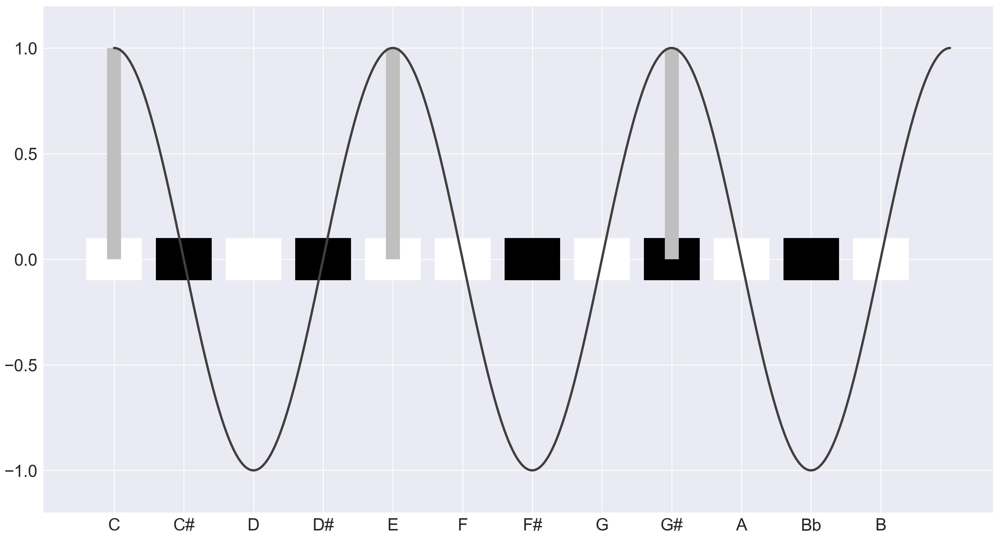

In [8]:
#keyboard_visu(pcd, True)
CAug = np.array([1,0,0,0,1,0,0,0,1,0,0,0])
keyboard_visu_with_coeff(CAug, 3, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(methodology_folder+'3cPrototype.eps')
plt.savefig(presentation_folder+'3cPrototype.png')

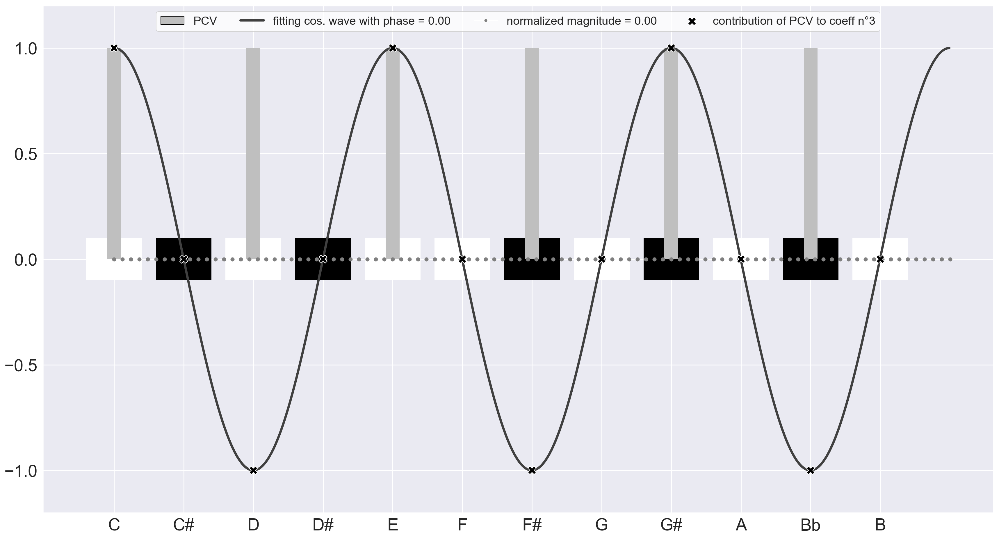

In [9]:
#keyboard_visu(pcd, True)
CwholeTone = np.array([1,0,1,0,1,0,1,0,1,0,1,0])
keyboard_visu_with_coeff(CwholeTone, 3, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=True, display_markers=True, display_legends=True, \
                         use_diatonic_label=False)
plt.savefig(methodology_folder+'3cPrototypeWholeTone.eps')

plt.savefig(presentation_folder+'3cPrototypeWholeTone.png')

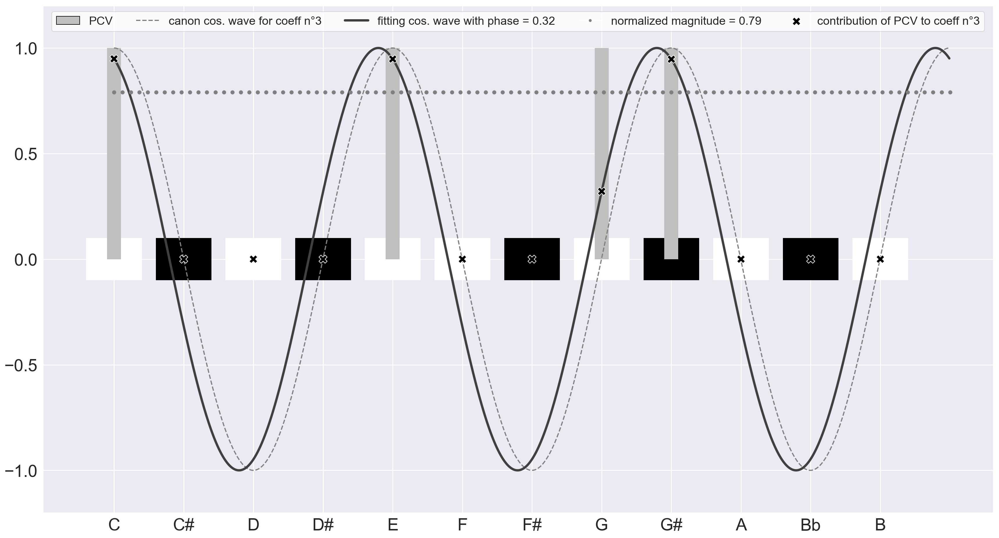

In [10]:
#keyboard_visu(pcd, True)
CaugFifth = np.array([1,0,0,0,1,0,0,1,1,0,0,0])
keyboard_visu_with_coeff(CaugFifth, 3, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=True, \
                         display_magn_line=True, display_markers=True, display_legends=True, \
                         use_diatonic_label=False)
plt.savefig(methodology_folder+'3cPrototypeAugFifth.eps')
plt.savefig(presentation_folder+'3cPrototypeAugFifth.png')

#### 4c Prototype

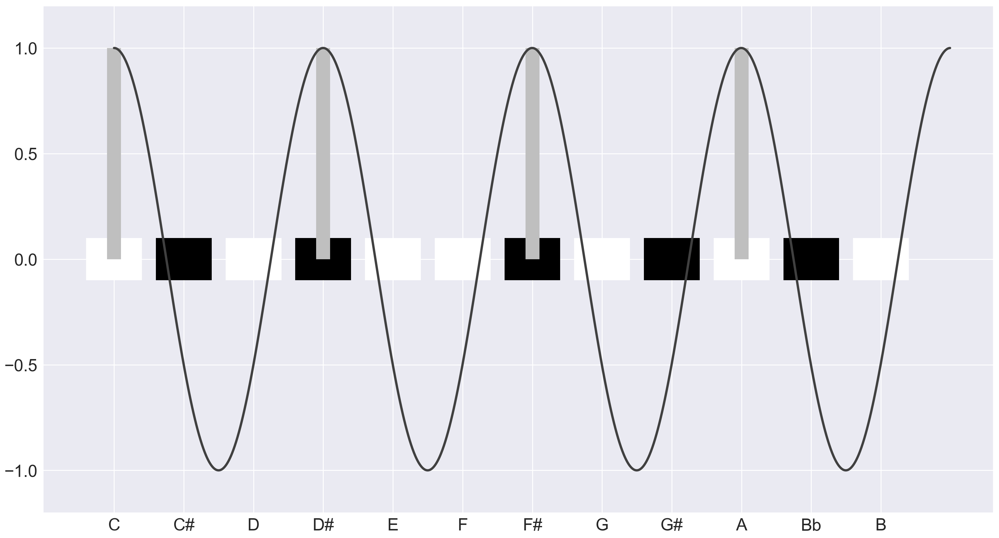

In [11]:
Cdim = np.array([1,0,0,1,0,0,1,0,0,1,0,0])

keyboard_visu_with_coeff(Cdim, 4, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(methodology_folder+'4cPrototype.eps')
plt.savefig(presentation_folder+'4cPrototype.png')

### 5c Prototypes

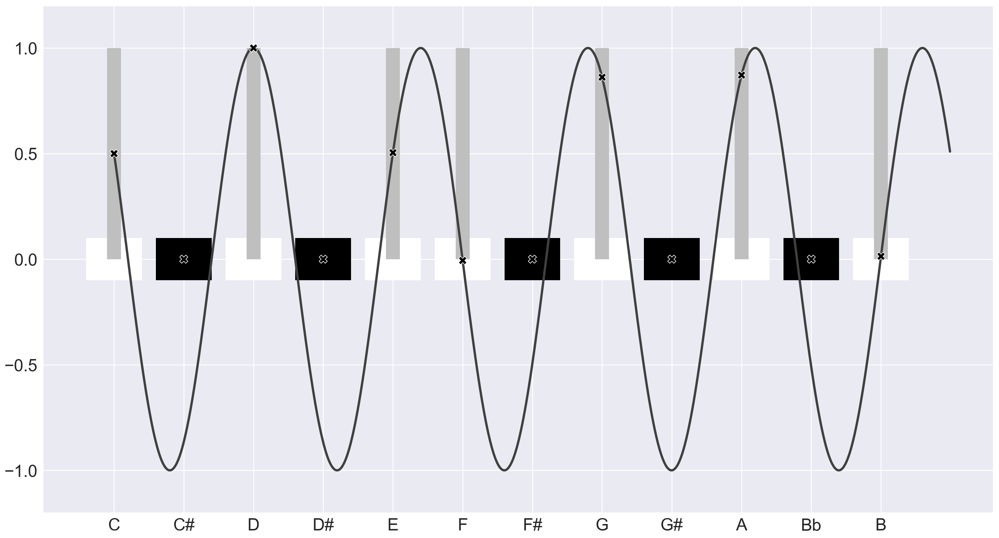

In [12]:
CMaj = np.array([1,0,1,0,1,1,0,1,0,1,0,1])

keyboard_visu_with_coeff(CMaj, 5, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=True, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(methodology_folder+'5cPrototype.eps')
plt.savefig(presentation_folder+'5cPrototype.png')

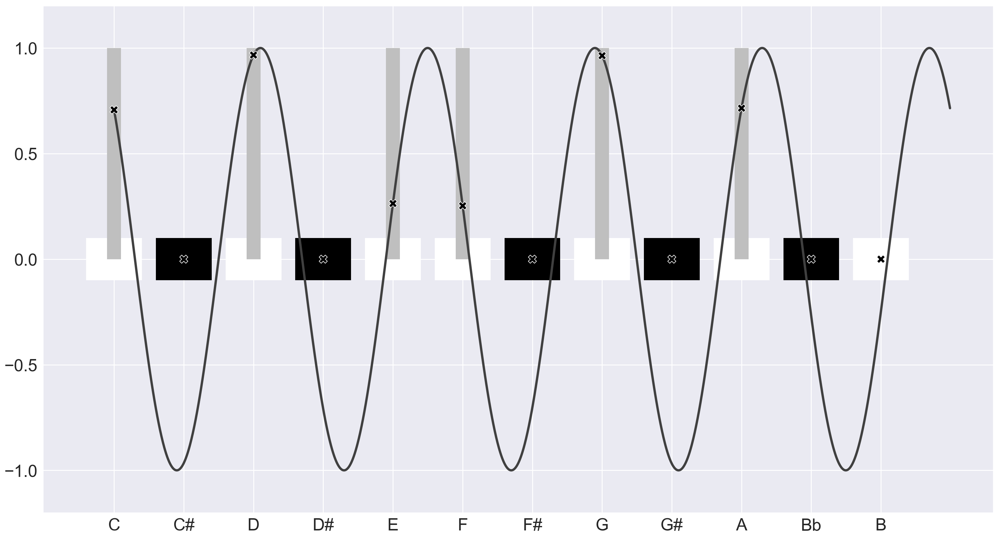

In [13]:
CMaj = np.array([1,0,1,0,1,1,0,1,0,1,0,0])

keyboard_visu_with_coeff(CMaj, 5, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=True, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(methodology_folder+'HexachordPrototype.eps')
plt.savefig(presentation_folder+'HexachordPrototype.png')

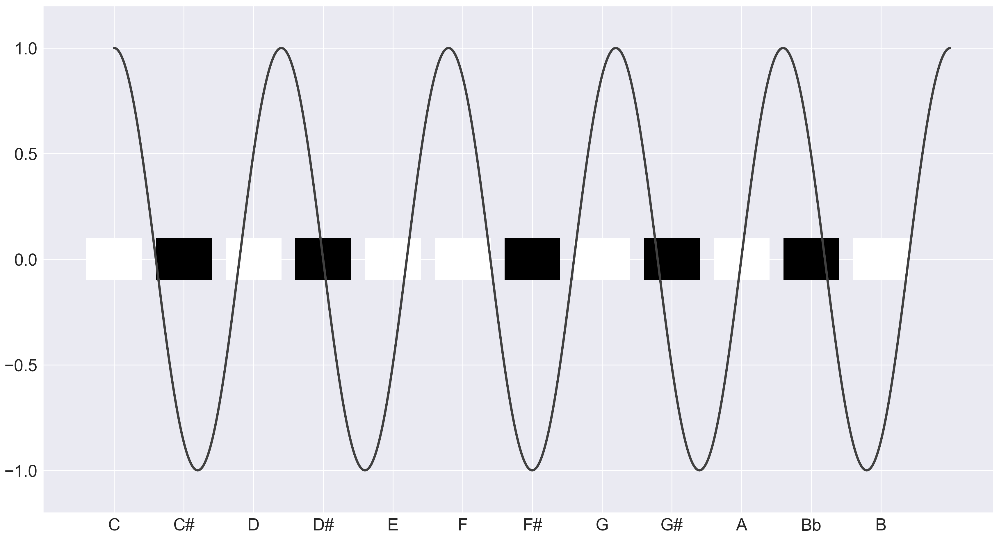

In [14]:
CMaj = np.array([1,0,0,0,0,0,0,0,0,0,0,0])

keyboard_visu_with_coeff(CMaj, 5, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False, display_pcd = False)
plt.savefig(methodology_folder+'5cWave.eps')
plt.savefig(presentation_folder+'5cWave.png')

### 1st, 2nd and 6th coefficient

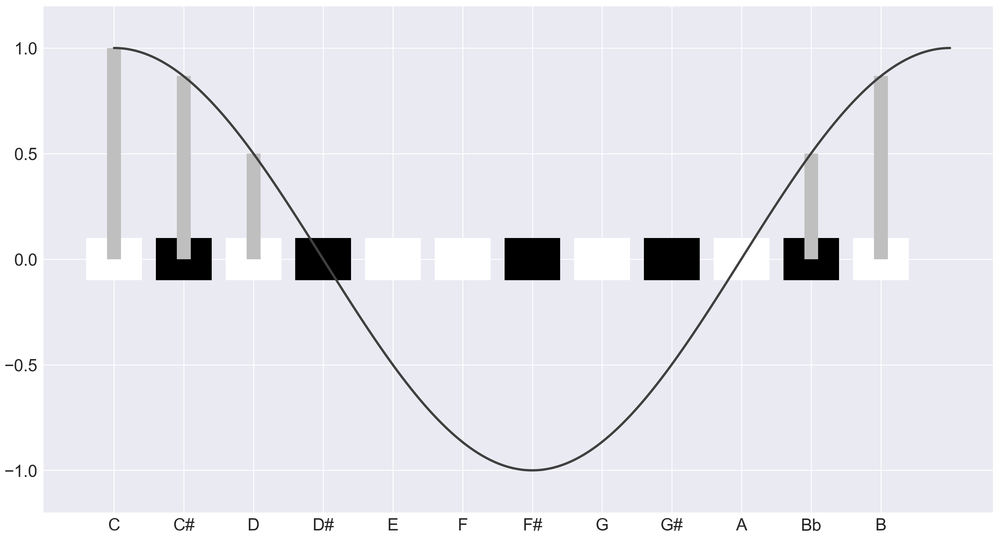

In [15]:
first_best_fit = np.array([1,0.867,0.5,0,0,0,0,0,0,0,0.5,0.867])

keyboard_visu_with_coeff(first_best_fit, 1, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(methodology_folder+'1cPrototype.eps')
plt.savefig(presentation_folder+'1cPrototype.png')

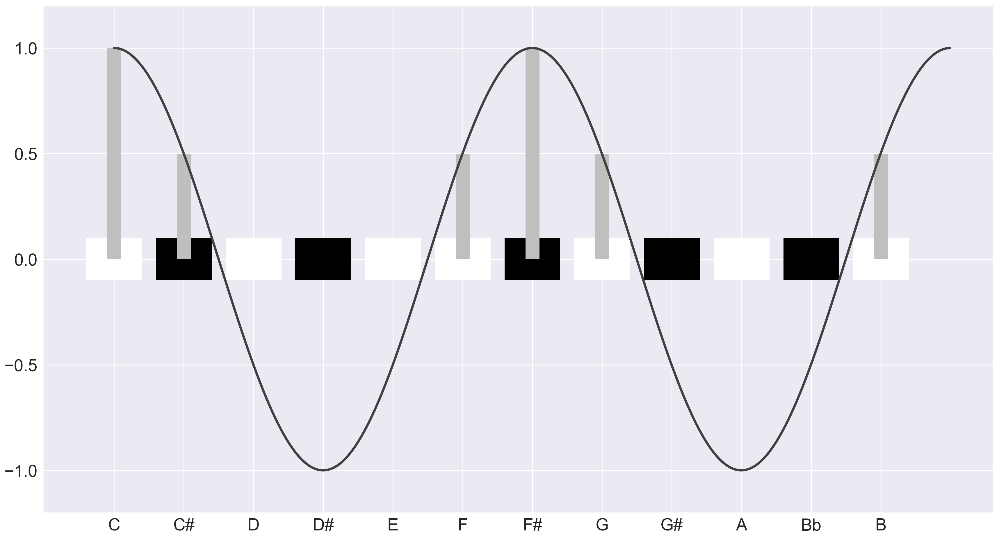

In [16]:
second_best_fit = np.array([1,.5,0,0,0,.5,1,.5,0,0,0,.5])

keyboard_visu_with_coeff(second_best_fit, 2, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False)

plt.savefig(methodology_folder+'2cPrototype.eps')
plt.savefig(presentation_folder+'2cPrototype.png')

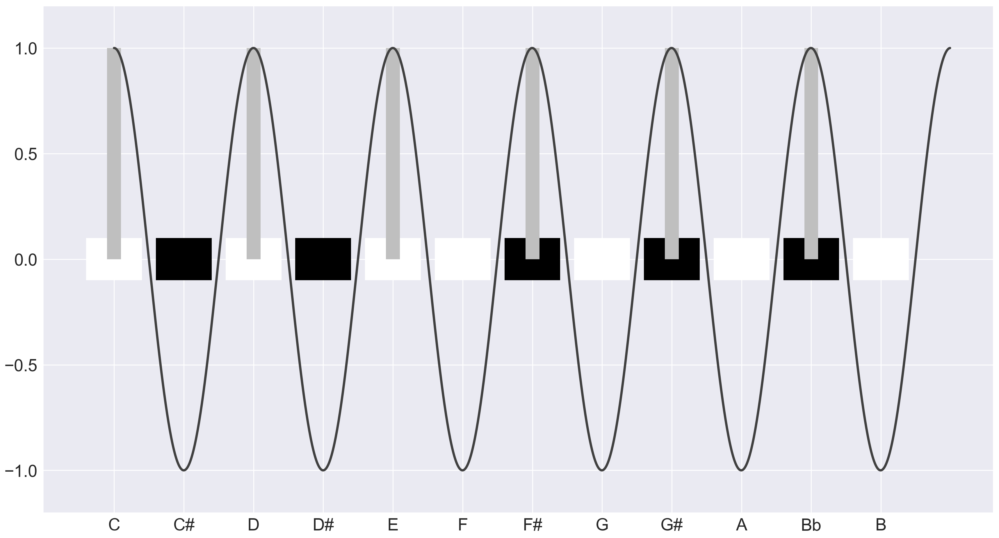

In [17]:
sixth_best_fit = np.array([1,0,1,0,1,0,1,0,1,0,1,0])

keyboard_visu_with_coeff(sixth_best_fit, 6, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False)

plt.savefig(methodology_folder+'6cPrototype.eps')
plt.savefig(presentation_folder+'6cPrototype.png')

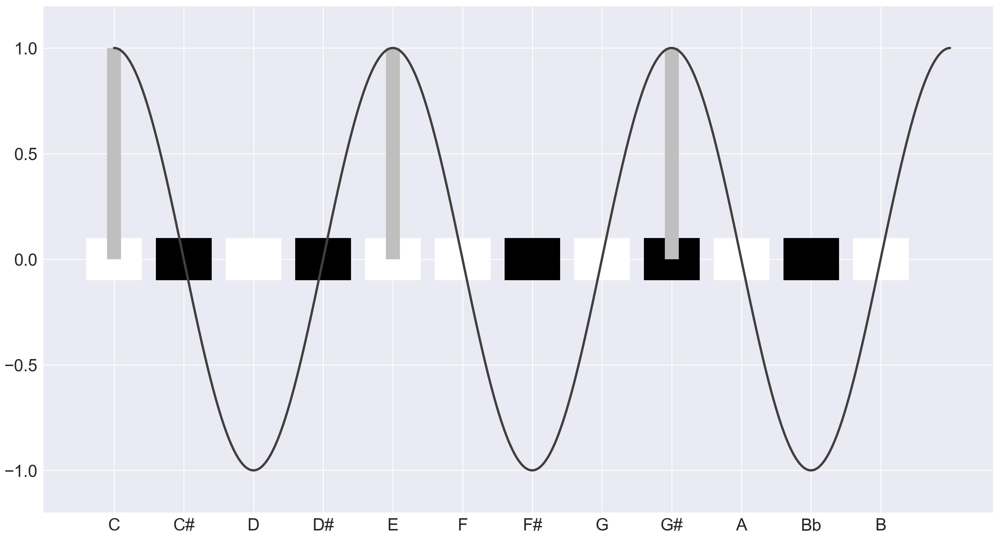

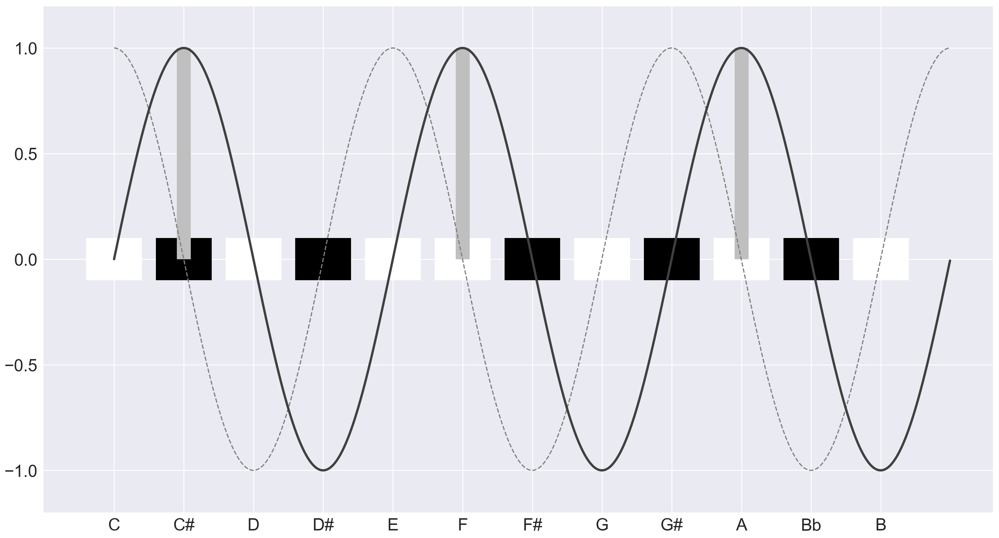

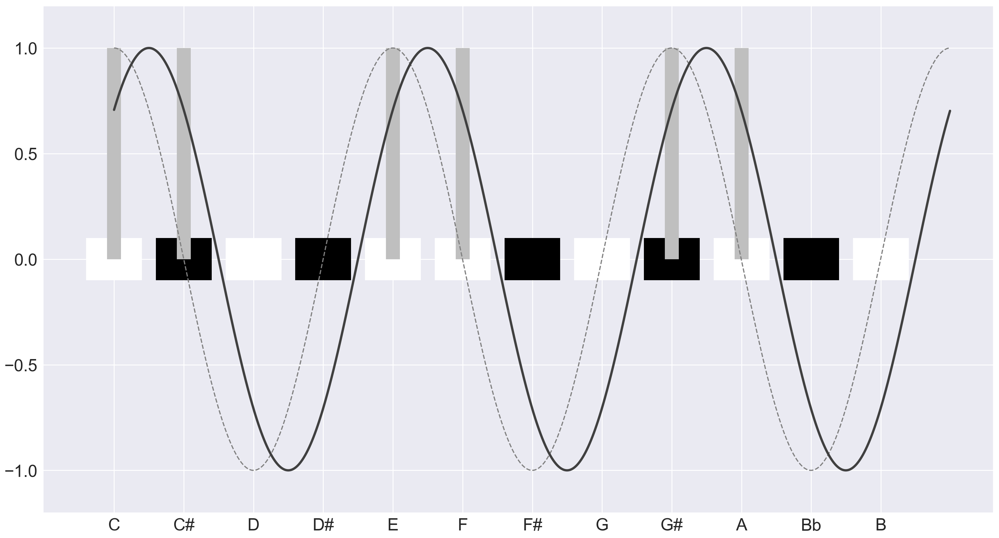

In [12]:
#keyboard_visu(pcd, True)
CAug = np.array([1,0,0,0,1,0,0,0,1,0,0,0])
CSharpAug = np.array([0,1,0,0,0,1,0,0,0,1,0,0])
keyboard_visu_with_coeff(CAug, 3, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=True, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(casestudy_folder+'CaugPhase.eps')
keyboard_visu_with_coeff(CSharpAug, 3, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=True, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(casestudy_folder+'CSharpAugPhase.eps')
keyboard_visu_with_coeff(CAug+CSharpAug, 3, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=True, \
                         display_magn_line=False, display_markers=False, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(casestudy_folder+'HexatonicPhase.eps')


## Some random formula for the presentation 

$ X[k] \in \mathbb{C}$ 

### Presentation: Pentatonic & Diatonic equivalence

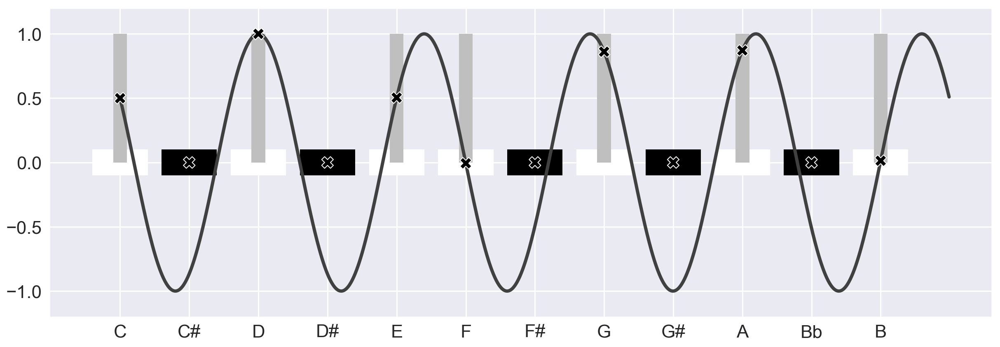

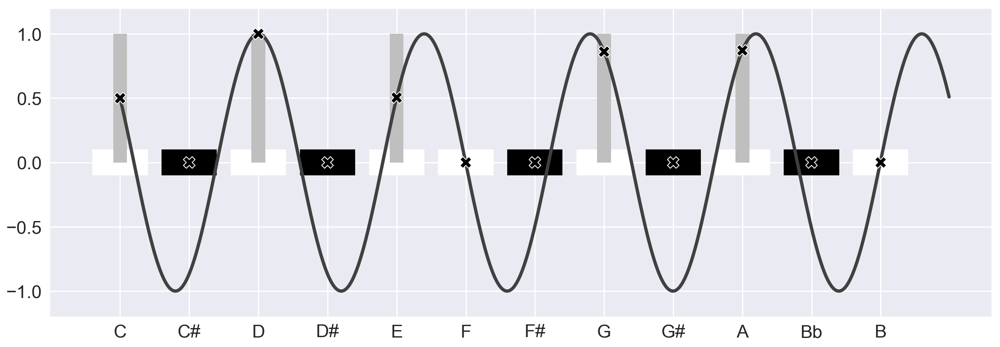

In [27]:
CMaj = np.array([1,0,1,0,1,1,0,1,0,1,0,1])
PentaEqui = np.array([1,0,1,0,1,0,0,1,0,1,0,0])
CSharpAug = np.array([0,1,0,0,0,1,0,0,0,1,0,0])
squized_plot_size = (17,6)
keyboard_visu_with_coeff(CMaj, 5, plot_size=squized_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=True, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(presentation_folder+'DiataonicWave.png')
keyboard_visu_with_coeff(PentaEqui, 5, plot_size=squized_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=False, display_markers=True, display_legends=False, \
                         use_diatonic_label=False)
plt.savefig(presentation_folder+'PentatonicWave.png')

### Complex plane for representation of the phase and magnitude 

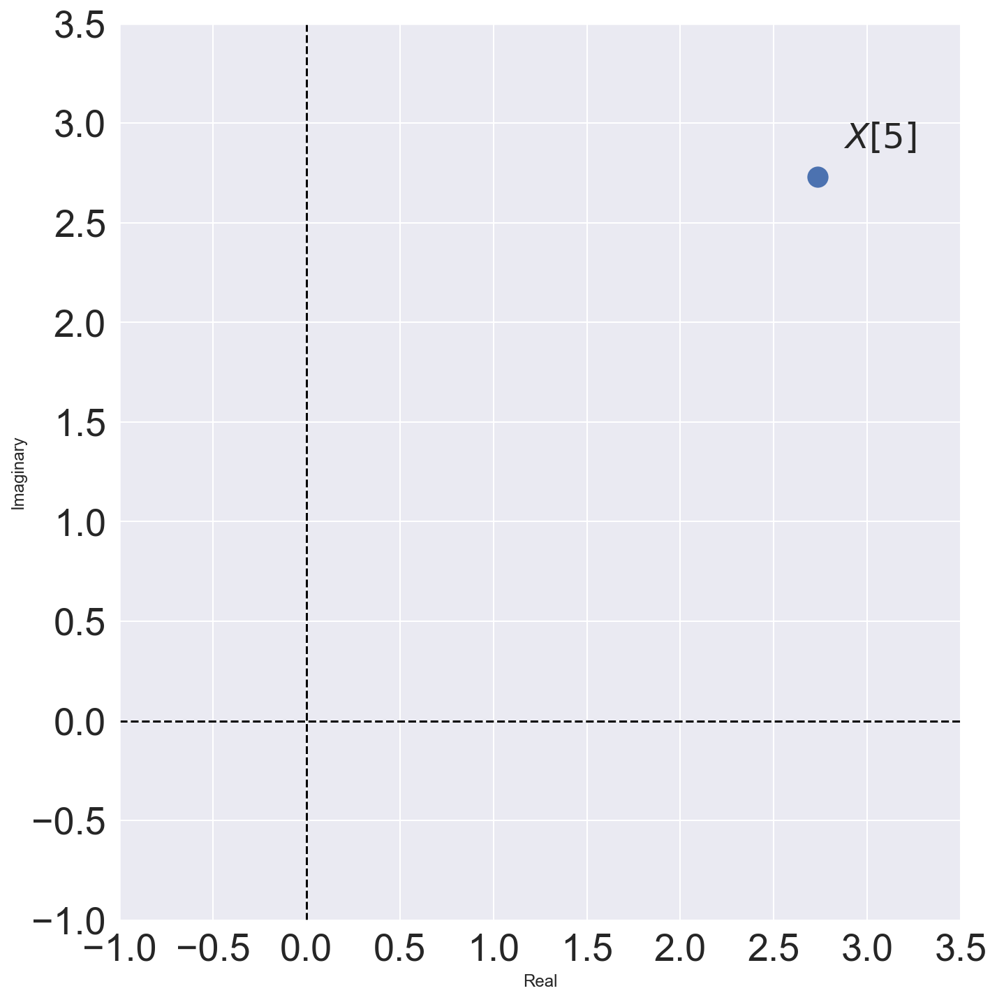

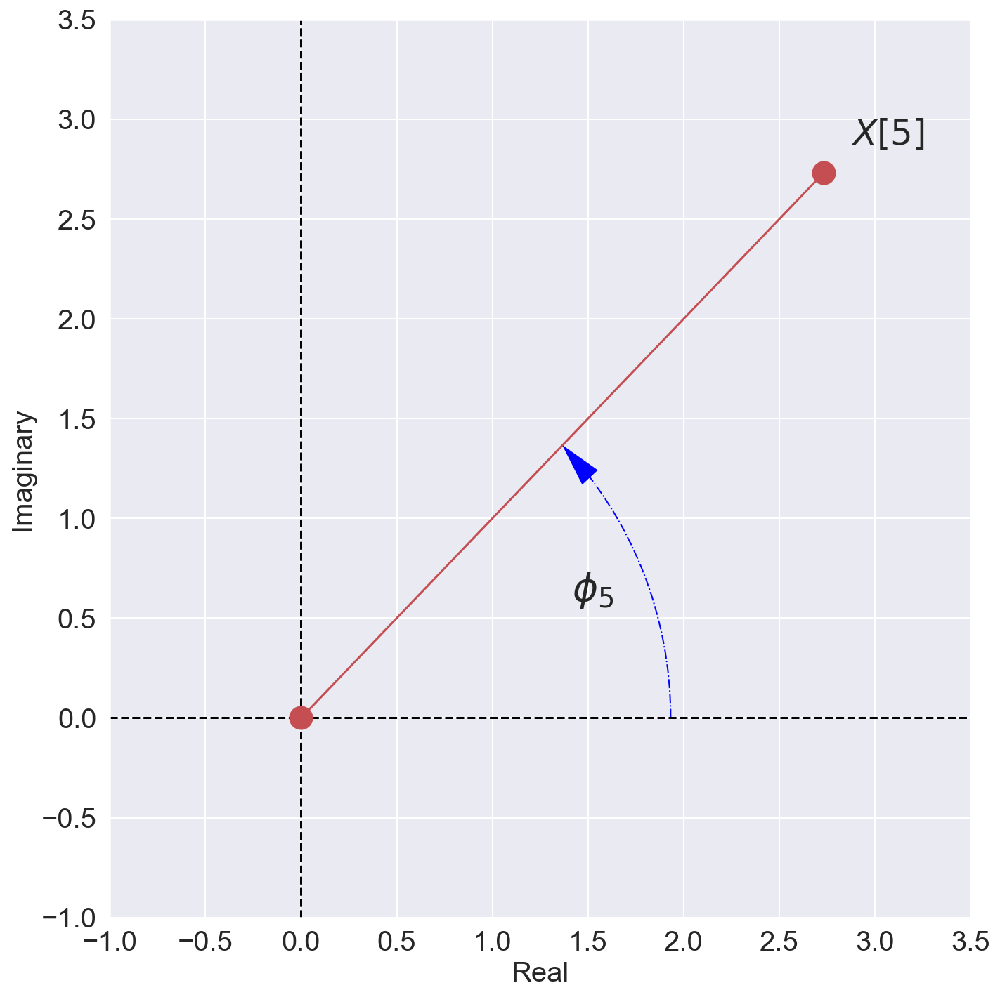

In [18]:
from matplotlib.patches import Arc

def argand(a, show_magn=True):
    font_size = 20
    bigger_font_size = font_size*1.25
    fig, ax = plt.subplots(figsize=(font_size/2,font_size/2))
    matplotlib.rc('xtick', labelsize=font_size)
    matplotlib.rc('ytick', labelsize=font_size)
    plt.rc('axes', labelsize=font_size)
    
    x = a.real
    y = a.imag
    arc_w = np.abs(a)[0]
    angle = (np.angle(a))[0] * (180/math.pi)

    ax.axhline(0, color='black', linestyle='--')
    ax.axvline(0, color='black', linestyle='--')
    if show_magn:
        
        label_x = (arc_w/2-0.4)*np.cos(np.angle(a)[0]/2)
        label_y = (arc_w/2-0.4)*np.sin(np.angle(a)[0]/2)
        ax.text(label_x, label_y, '$\phi_5$', fontdict={'size':bigger_font_size*1.1})
        
        arrow_x = (arc_w/2)*np.cos(np.angle(a)[0]-0.11)
        arrow_y = (arc_w/2)*np.sin(np.angle(a)[0]-0.11)
        dxdy = np.array([x[0]/2, y[0]/2]) - np.array([arrow_x, arrow_y])
        arc_arrow_dx = dxdy[0]
        arc_arrow_dy = dxdy[1]
        ax.arrow(
            arrow_x,
            arrow_y,
            arc_arrow_dx*0.00001,
            arc_arrow_dy*0.00001,
            head_width=0.1,
            head_length=0.2,
            color='blue')
        arc = Arc((0,0), arc_w, arc_w, angle = 0, theta1=0, theta2=angle, linestyle='dashdot', color='blue')
        ax.add_patch(arc)
        
        plt.plot([0,a.real],[0,a.imag],'ro-',label='python', markersize=font_size*0.8)
    else:
        plt.scatter(a.real,a.imag, s=[font_size*10])

    coeff_x = (arc_w+0.2)*np.cos(np.angle(a)[0])
    coeff_y = (arc_w+0.2)*np.sin(np.angle(a)[0])
    ax.text(coeff_x, coeff_y, '$X[5]$', fontdict={'size':bigger_font_size})
    limit=np.max(np.floor(np.absolute(a))) # set limits for axis
    plt.xlim((-1,limit+.5))
    plt.ylim((-1,limit+.5))
    plt.ylabel('Imaginary')
    plt.xlabel('Real')
    plt.tight_layout()
    #plt.show()
    
argand(np.array([2.7323]) + 1j*np.array([2.7323]), False)
plt.savefig(methodology_folder+'ComplexPlane.eps')
argand(np.array([2.7323]) + 1j*np.array([2.7323]), True)
#plt.savefig(methodology_folder+'MagnitudePhase.eps')
plt.savefig(presentation_folder+'MagnitudePhase.png')

### Circle with phase indicators related to pi.

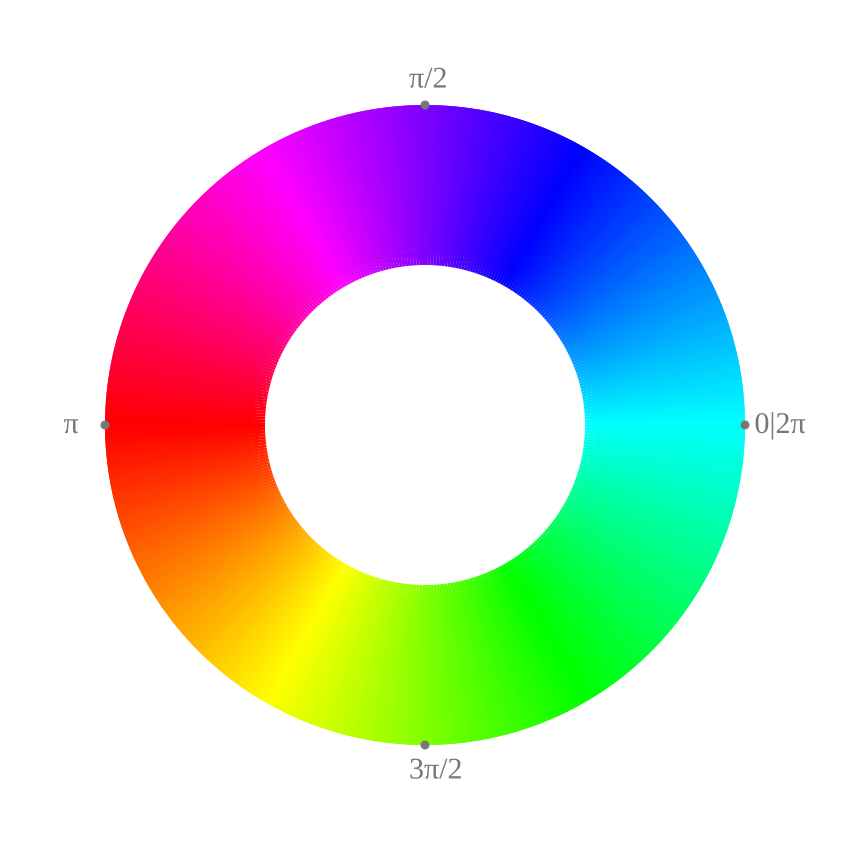

In [27]:

def draw_point_on_the_circle(canvas, angle, label, color, arc_w, display_label=True):
    x = math.cos(angle)
    y = math.sin(angle)
    canvas.append(draw.Circle(x*arc_w, y*arc_w, 4,
        fill=color, stroke=color))
    if display_label:
        text_width = 20
        label_offset = 15
        x_label = x*(1+text_width/(2*arc_w))*(1+label_offset/arc_w) - 0.05
        y_label = y*(1+text_width/(2*arc_w))*(1+label_offset/arc_w) -0.025
        canvas.append(draw.Text(label, text_width+10, x_label*arc_w, y_label*arc_w, fill=color))
    return canvas


def draw_circle_color_space(color_mapping_func, label_angle_dict, draw_width, add_zero_degree=True, add_labels=True):
    canvas_width = draw_width + draw_width/16
    canvas_height = draw_width + draw_width/16
    canvas = draw.Drawing(width=canvas_width, height=canvas_height, origin="center")
    #order of coordinates for Rectangle: 1:x coord of top right corner 2: y coord of top left corner 3: x axis len 4: y axis len
    canvas.append(draw.Rectangle(-canvas_width/2,-canvas_height/2,canvas_width,canvas_height, fill='white'))
    lower_arc_w = 0.2*draw_width
    higher_arc_w = 0.4*draw_width
    for i in range(-180, 180):
        angle_color = rgb_to_hex(color_mapping_func(i*(math.pi/180)))
        p = draw.Path(fill=angle_color)
        #i+2 so that the slight overlap hides the seams. 
        p.arc(0,0,higher_arc_w,i,i+2)
        p.arc(0,0,lower_arc_w,i+1,i,cw=True, includeL=True)
        canvas.append(p)
        
    for  label, angle in label_angle_dict.items():
        if len(label) > 0 and label[-1] == 'm':
            draw_point_on_the_circle(canvas, angle, label, "#000000", lower_arc_w, add_labels)
        else:
            draw_point_on_the_circle(canvas, angle, label, "#777777", higher_arc_w, add_labels)
    if add_zero_degree:
        draw_point_on_the_circle(canvas, 0, '0°', '#000000', higher_arc_w)
    return canvas


circle_fig = draw_circle_color_space(circular_hue, {'0|2π': 0 ,'π': math.pi, 'π/2': math.pi/2, '3π/2': 3*math.pi/2, },800, add_zero_degree=False)
saveToJpeg(circle_fig, 'circle_color_space', methodology_folder)
circle_fig

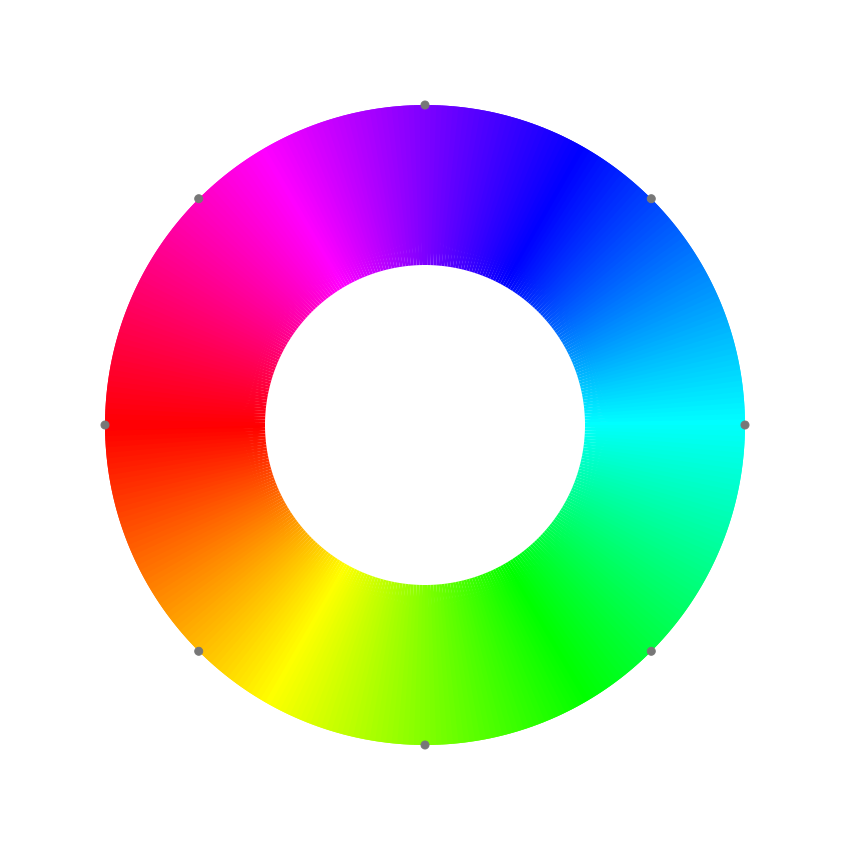

In [12]:
def draw_circle_color_space(color_mapping_func, label_angle_dict, draw_width, add_zero_degree=True, add_labels=True):
    canvas_width = draw_width + draw_width/16
    canvas_height = draw_width + draw_width/16
    canvas = draw.Drawing(width=canvas_width, height=canvas_height, origin="center")
    #order of coordinates for Rectangle: 1:x coord of top right corner 2: y coord of top left corner 3: x axis len 4: y axis len
    canvas.append(draw.Rectangle(-canvas_width/2,-canvas_height/2,canvas_width,canvas_height, fill='white'))
    lower_arc_w = 0.2*draw_width
    higher_arc_w = 0.4*draw_width
    for i in range(-180, 180):
        angle_color = rgb_to_hex(color_mapping_func(i*(math.pi/180)))
        p = draw.Path(fill=angle_color)
        #i+2 so that the slight overlap hides the seams. 
        p.arc(0,0,higher_arc_w,i,i+2)
        p.arc(0,0,lower_arc_w,i+1,i,cw=True, includeL=True)
        canvas.append(p)
        
    for  angle, label in label_angle_dict.items():
        if len(label) > 0 and label[-1] == 'm':
            draw_point_on_the_circle(canvas, angle, label, "#000000", lower_arc_w, add_labels)
        else:
            draw_point_on_the_circle(canvas, angle, label, "#777777", higher_arc_w, add_labels)
    if add_zero_degree:
        draw_point_on_the_circle(canvas, 0, '0°', '#000000', higher_arc_w)
    return canvas



circle_fig = draw_circle_color_space(circular_hue, { 0:'' ,math.pi:'', math.pi/2:'', 3*math.pi/2:'',\
                                                    math.pi/4:'', 3*math.pi/4:'', 5*math.pi/4:'', 7*math.pi/4:''},\
                                     800, add_zero_degree=False)
saveToJpeg(circle_fig, 'circle_color_space_labeless', methodology_folder)
circle_fig

### Need to have hexatonic and Diatonic legends + the PI thing in only one plot

In [4]:
hexa_aug_dict = { 0:'m' ,math.pi:'m', math.pi/2:'m', 3*math.pi/2:'m',\
            math.pi/4:'m', 3*math.pi/4:'m', 5*math.pi/4:'m', 7*math.pi/4:'m'}

dia_key = ['C', 'Db', 'D', 'Eb', 'E', 'F', 'Gb', 'G', 'Ab', 'A', 'Bb', 'B']
C_Maj = [1,0,1,0,1,1,0,1,0,1,0,1]
label_phase_dia_dict = { nth_coeff_phase(np.roll(C_Maj, i), 5) : dia_key[i] for i in range(len(dia_key))}

nswe = { 0:'p' ,math.pi:'p', math.pi/2:'p', 3*math.pi/2:'p'}


''

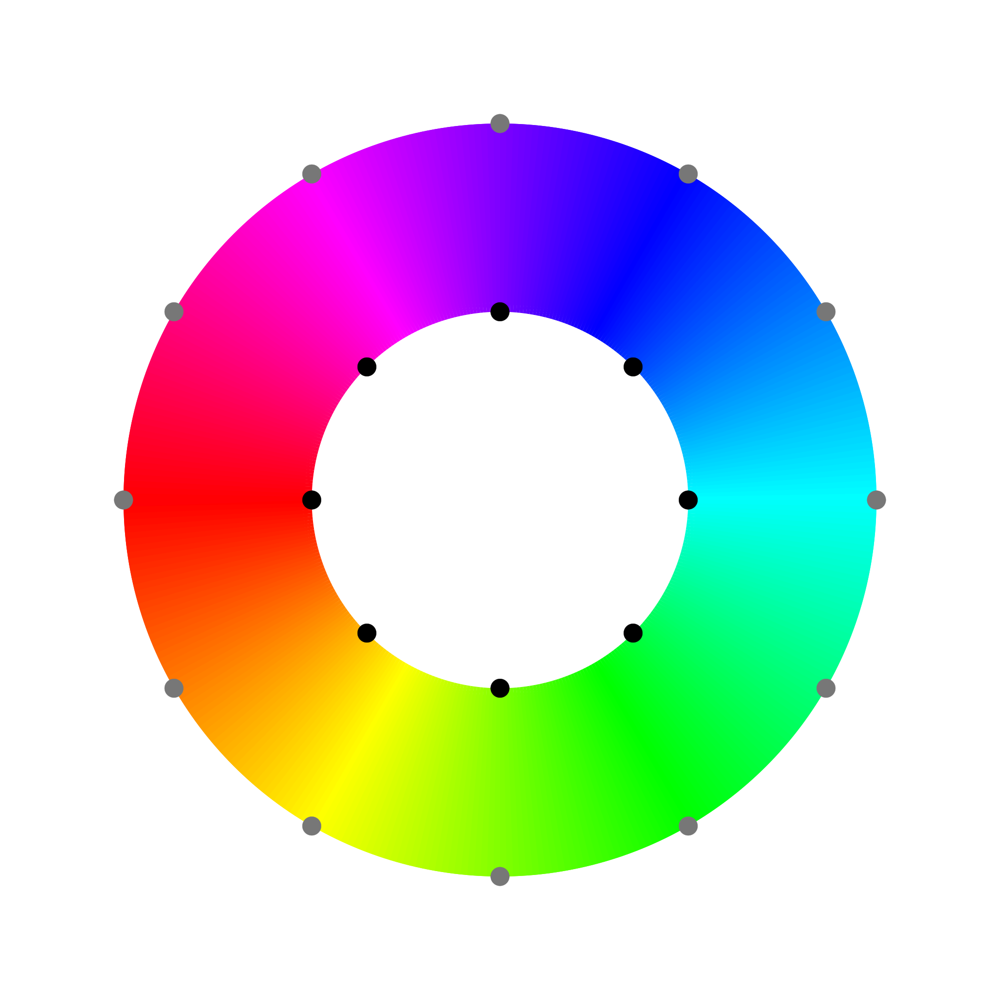

In [16]:
def draw_point_on_the_circle(canvas, angle, label, color, arc_w, display_label=True, point_radius=4):
    x = math.cos(angle)
    y = math.sin(angle)
    canvas.append(draw.Circle(x*arc_w, y*arc_w, point_radius,
        fill=color, stroke=color))
    if display_label:
        text_width = 20
        label_offset = 15
        x_label = x*(1+text_width/(2*arc_w))*(1+label_offset/arc_w)
        y_label = y*(1+text_width/(2*arc_w))*(1+label_offset/arc_w)
        canvas.append(draw.Text(label, text_width, x_label*arc_w, y_label*arc_w, fill=color))
    return canvas

def draw_circle_on_the_circle(canvas, angle, color, arc_w, point_radius=4):
    x = math.cos(angle)
    y = math.sin(angle)
    transparent = '#ffffff00'
    canvas.append(draw.Circle(x*arc_w, y*arc_w, point_radius*2,
        fill=transparent, stroke=color))
    return canvas

def draw_circle_color_space(color_mapping_func, list_of_label_angle_dict, draw_width, add_zero_degree=True, add_labels=True):
    canvas_width = draw_width + draw_width/16
    canvas_height = draw_width + draw_width/16
    canvas = draw.Drawing(width=canvas_width, height=canvas_height, origin="center")
    #order of coordinates for Rectangle: 1:x coord of top right corner 2: y coord of top left corner 3: x axis len 4: y axis len
    canvas.append(draw.Rectangle(-canvas_width/2,-canvas_height/2,canvas_width,canvas_height, fill='white'))
    lower_arc_w = 0.2*draw_width
    higher_arc_w = 0.4*draw_width
    for i in range(-180, 180):
        angle_color = rgb_to_hex(color_mapping_func(i*(math.pi/180)))
        p = draw.Path(fill=angle_color)
        #i+2 so that the slight overlap hides the seams. 
        p.arc(0,0,higher_arc_w,i,i+2)
        p.arc(0,0,lower_arc_w,i+1,i,cw=True, includeL=True)
        canvas.append(p)
        
    point_size = draw_width/100
    for label_angle_dict in list_of_label_angle_dict:
        for  angle, label in label_angle_dict.items():
            if len(label) > 0 and label[-1] == 'm':
                draw_point_on_the_circle(canvas, angle, label[:-1], "#000000", lower_arc_w, add_labels, point_radius=point_size)
            elif label[-1] == 'p':
                draw_circle_on_the_circle(canvas, angle, "#000000", higher_arc_w, point_radius=point_size)
            else:
                draw_point_on_the_circle(canvas, angle, label, "#777777", higher_arc_w, add_labels, point_radius=point_size)
    if add_zero_degree:
        draw_point_on_the_circle(canvas, 0, '0°', '#000000', higher_arc_w)
    return canvas

canv = draw_circle_color_space(circular_hue, [hexa_aug_dict, label_phase_dia_dict], 5000, add_labels=False,add_zero_degree=False)
canv.savePng(tmp_png+'absolute_circle_color_space_labeless.png')
canv

## Case Study

### Faust Symphony's 3rd coefficient wavescape and subwavescapes

#### Whole keyscape

In [14]:
wavescape_one_coeff(midi_files_folder+faust_symphony_midi, 3000, 3, output_folder = casestudy_folder, \
                        draw_indicators = True, draw_line = False)

### With line delimiters 

In [62]:
def wavescape_one_coeff_plus_triangles(filepath, resolution, coeff, tr_li_idx, output_folder = False):
    pcs_array = pcv_from_filepath(filepath, resolution)
    elem_numb = len(pcs_array)
    ws = wavescape_out_of_pc_vector(pcs_array, resolution, coeff, draw_indicators=True, draw_line=False)
    
    
    diamond_w = resolution/elem_numb
    black = '#000000ff'
    transparent = '#00000000'
    half_w = resolution/2
    strok_width = resolution/300
    for lo, hi in tr_li_idx:
        
        left_cx = (lo * diamond_w) - diamond_w/2 - half_w
        bottom_cy = 0 - half_w + strok_width/2 # + strok_width so the bottom of the line is not cut
        right_cx = ((hi+1) * diamond_w) + diamond_w/2 - half_w
        
        top_cx = (left_cx+right_cx)/2
        top_cy = right_cx-left_cx - half_w + diamond_w/2
        '''
        p = draw.Path(stroke_width=resolution/300, stroke=black,
              fill=black, fill_opacity=1)
        p.M(left_cx,bottom_cy)  # Start path at point
        p.h(right_cx)    # Draw horizontal line to x=right_cx
        p.l(top_cx,top_cy)  # Draw line to (top_cx, top_cy)
        p.Z()       # Draw line to start
        
        ws.append(p)
        '''
        ws.append(draw.Lines(
            left_cx, bottom_cy,
            right_cx, bottom_cy,
            top_cx, top_cy,
            left_cx-strok_width+1, bottom_cy-strok_width+1, # -strok_width so the triangle's path is nicely closed
            fill=transparent,
            stroke=black,
            stroke_width=strok_width))
    if output_folder:        
        filename = extract_filename(filepath)
        ws.saveSvg(tmp_png+filename+'_%dc_triangles.svg'%coeff)
        #saveToJpeg(ws, filename + '_%dc_triangles'%coeff, output_folder)
    else:
        return ws

    
wavescape_one_coeff_plus_triangles(midi_files_folder+faust_symphony_midi, 705, 3, \
                                   [(8,17), (46, 53)], output_folder=casestudy_folder)

### Phase Circle + Ro1 & Ro2 scores

In [16]:
convertTempPngToTif('hexatonic_poles', casestudy_folder)
convertTempPngToTif('fsro1score', casestudy_folder)
convertTempPngToTif('fsro2score', casestudy_folder)

#### Region of Interest 1

In [17]:
wavescape_one_coeff(midi_files_folder+fs_ro1, big_resolution, 3, output_folder = casestudy_folder, \
                        draw_indicators = False, draw_line = True)

#### Region of Interest 2

In [18]:
wavescape_one_coeff(midi_files_folder+fs_ro2, big_resolution, 3, output_folder = casestudy_folder, \
                        draw_indicators = False, draw_line = True)

#### ROI2 PCV & Sine Wave

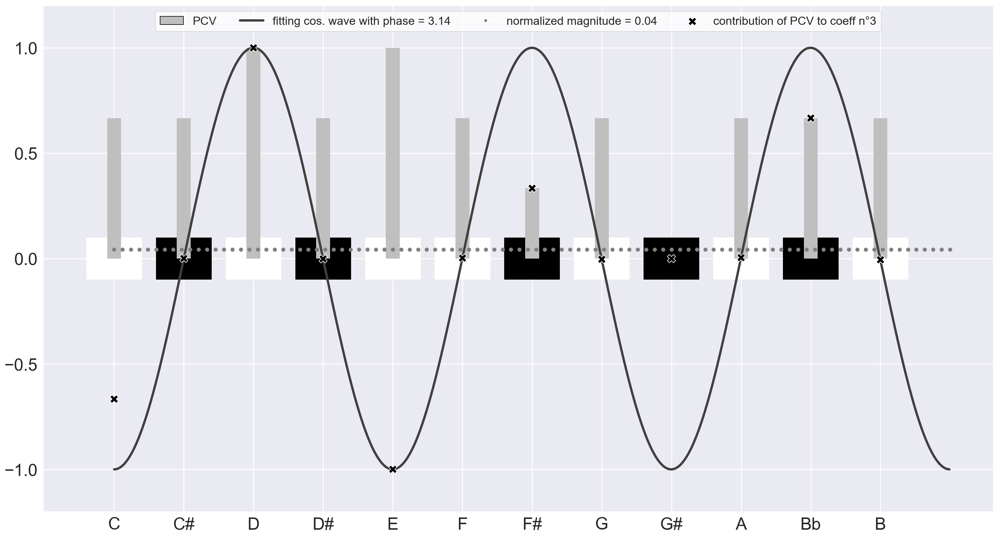

In [32]:
ROI2Pcv = np.array([.5,.5,.75,.5,.75,.5,.25,.5,0,.5,.5,.5])
keyboard_visu_with_coeff(ROI2Pcv, 3, plot_size=uniform_plot_size, display_sine=True, display_canon_sine=False, \
                         display_magn_line=True, display_markers=True, display_legends=True, \
                         use_diatonic_label=False)
plt.savefig(casestudy_folder+'Roi2AllTones.eps')

### Collage for Musical Pieces

#### Faust Symphony

In [8]:
res

NameError: name 'res' is not defined

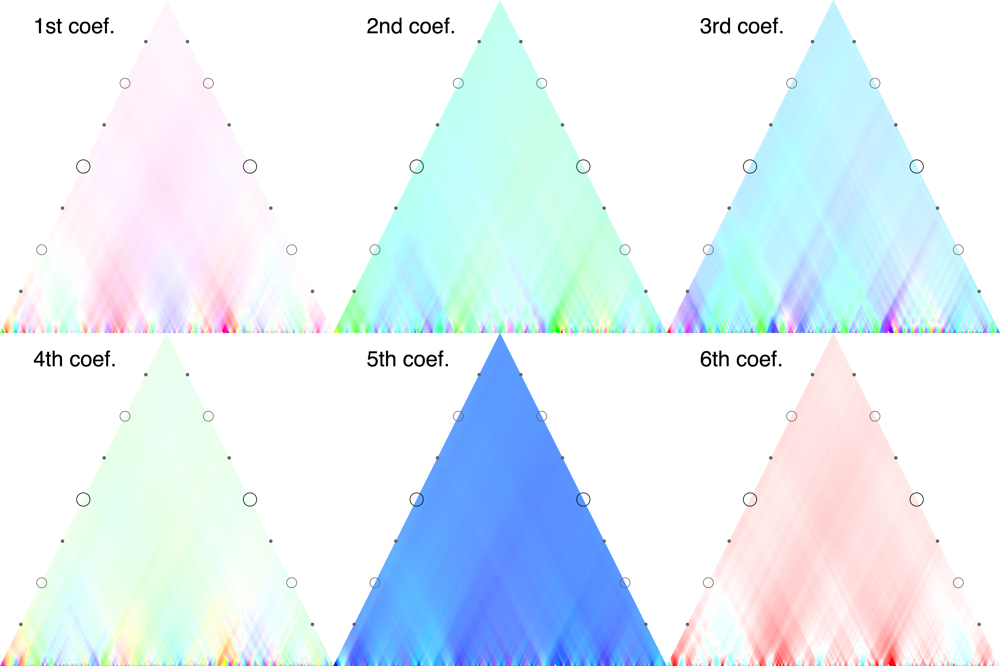

In [15]:
res = six_wavescapes_collage(midi_files_folder+pale, \
                       very_big_resolution, 'palestrinafull')
res

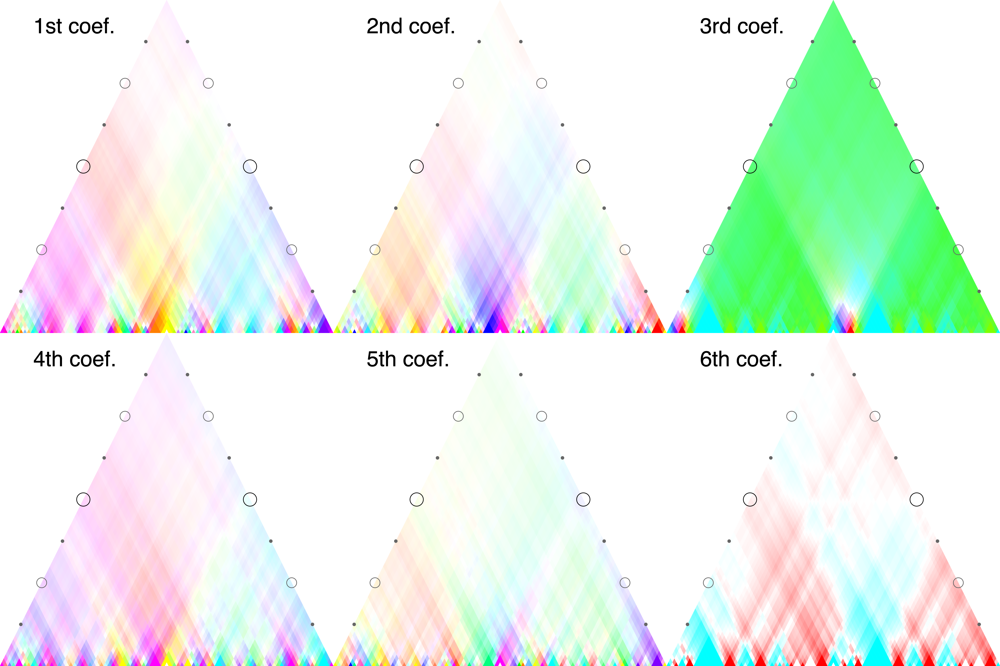

In [38]:
_ = six_wavescapes_collage(midi_files_folder+faust_symphony_midi, \
                       very_big_resolution, casestudy_folder+'FaustSymponyMidiAllCoeffs')

#### Bach Prelude in C Major

In [39]:
_ = six_wavescapes_collage(midi_files_folder+bach_prelude, \
                       very_big_resolution, casestudy_folder+'BachPreludeAllCoeffs')

### Circular hue of diatonic keys

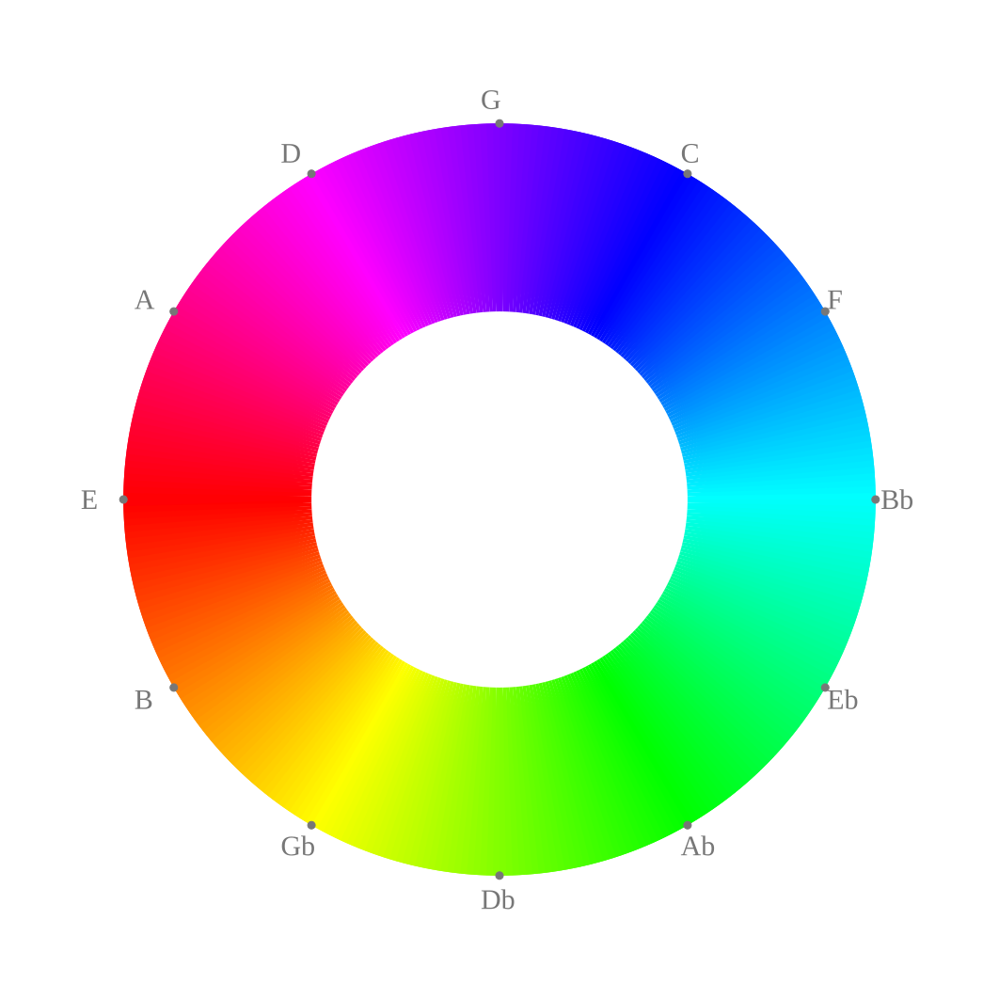

In [26]:
dia_key = ['C', 'Db', 'D', 'Eb', 'E', 'F', 'Gb', 'G', 'Ab', 'A', 'Bb', 'B']
C_Maj = [1,0,1,0,1,1,0,1,0,1,0,1]
label_phase_dia_dict = { nth_coeff_phase(np.roll(C_Maj, i), 5) : dia_key[i] for i in range(len(dia_key))}

circle_dia_fig = draw_circle_color_space(circular_hue, label_phase_dia_dict,1000, add_zero_degree=False)
saveToJpeg(circle_dia_fig, 'circular_hue_diatonic', casestudy_folder)
circle_dia_fig

#### Giant Steps

In [40]:
_ = six_wavescapes_collage(midi_files_folder+giant_steps_midi, \
                       very_big_resolution, casestudy_folder+'GiantStepsMidiAllCoeffs')

#### Anton Webern Variation for Piano n°1

In [41]:
_ = six_wavescapes_collage(midi_files_folder+webern_variations, \
                       very_big_resolution, casestudy_folder+'WebernVariation1AllCoeffs')

## Bonus

### Wav vs MIDI: Faust Symphony

In [47]:
# midi_vs_wav_wavescapes_collage(midi_files_folder+faust_symphony_midi, audio_files_folder+faust_symphony_wav,\
#                                very_big_resolution, 3, \
#                                bonus_folder+'fs_midi_vs_wav_horizontal', horizontal_orientation = True)

# midi_vs_wav_wavescapes_collage(midi_files_folder+faust_symphony_midi, audio_files_folder+faust_symphony_wav,\
#                                very_big_resolution, 3, \
#                                bonus_folder+'fs_midi_vs_wav_vertical', horizontal_orientation = False)


wavescape_one_coeff(midi_files_folder+faust_symphony_midi, resolution=very_big_resolution, coeff=3,\
                    output_folder = bonus_folder+'fs_midi_5c', draw_indicators = True, draw_line = False)


wavescape_one_coeff(audio_files_folder+faust_symphony_wav, resolution=very_big_resolution, coeff=3,\
                    output_folder = bonus_folder+'fs_wav_5c', draw_indicators = True, draw_line = False)

### Wav vs MIDI: Giant Steps

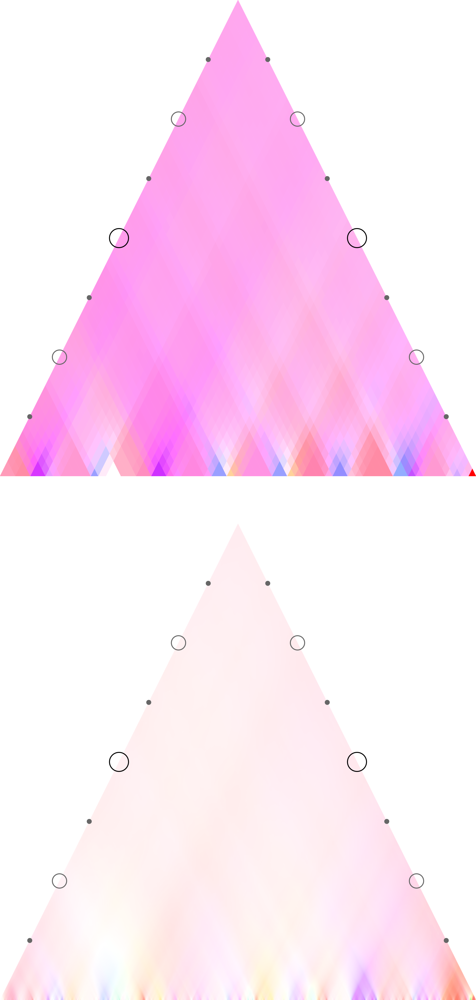

In [26]:
# midi_vs_wav_wavescapes_collage(midi_files_folder+giant_steps_midi, audio_files_folder+giant_steps_wav,\
#                                very_big_resolution, 3, \
#                                bonus_folder+'gs_midi_vs_wav_horizontal', horizontal_orientation = True)

# midi_vs_wav_wavescapes_collage(midi_files_folder+giant_steps_midi, audio_files_folder+giant_steps_wav,\
#                                very_big_resolution, 3, \
#                                bonus_folder+'gs_midi_vs_wav_vertical', horizontal_orientation = False)

In [49]:
# midi_vs_wav_wavescapes_collage(midi_files_folder+giant_steps_midi, audio_files_folder+giant_steps_wav,\
#                                very_big_resolution, 5, \
#                                bonus_folder+'gs_midi_vs_wav_horizontal_5c', horizontal_orientation = True)

wavescape_one_coeff(midi_files_folder+giant_steps_midi, resolution=very_big_resolution, coeff=5,\
                    output_folder = bonus_folder+'gs_midi_5c', draw_indicators = True, draw_line = False)

# midi_vs_wav_wavescapes_collage(midi_files_folder+giant_steps_midi, audio_files_folder+giant_steps_wav,\
#                                very_big_resolution, 5, \
#                                bonus_folder+'gs_midi_vs_wav_vertical_5c', horizontal_orientation = False)

wavescape_one_coeff(audio_files_folder+giant_steps_wav, resolution=very_big_resolution, coeff=5,\
                    output_folder = bonus_folder+'gs_wav_5c', draw_indicators = True, draw_line = False)

## High & Low COM keyscapes

In [27]:
def center_of_mass_height(utm):
    magn_sum = np.sum(utm)
    N = np.shape(utm)[0]
    curr_sum = 0.
    for i in range(N):
        for j in range(i, N):
            curr_sum += (i+1)*utm[i][j]
    return (curr_sum/magn_sum) - 1.

def keyscape_with_center_of_mass_height(pcv_arr, coefficient, keyscape_size):
    if pcv_arr is not None and len(pcv_arr) > 0:
        utm_dim = len(pcv_arr)
        magn_utm = angle_magnitude_utms_production(pcv_arr, coefficient)[1]
        com = (center_of_mass_height(magn_utm)+1.)/float(utm_dim)
        print(com)
        utm = generalized_keyscape(pcv_arr, lambda v: color_mapping_phase_and_magnitude_with_opacity(v, coefficient))
        ks = Keyscape(utm, keyscape_size)
        ks.generate_diamonds()
        res = ks.draw()
        # adding line indicating the center of mass
        half_ks_size = int(keyscape_size/2.)
        keyscape_com_height = int((com)*float(keyscape_size)) - half_ks_size
        res.append(draw.Lines(-half_ks_size, keyscape_com_height,
                            half_ks_size, keyscape_com_height,
                            close=False,
                    fill='#eeee00',
                    stroke='black'))
        return res
    else:
        raise Exception("Pitch class vector array non existent or empty")
        
        
def wavescape_one_coeff_with_com(filepath, resolution, coeff, output_folder = False):
    pcs_array = pcv_from_filepath(filepath, resolution)
    ws = keyscape_with_center_of_mass_height(pcs_array, coeff, resolution)
        
    if output_folder:        
        filename = extract_filename(filepath)
        saveToJpeg(ws, filename + '_com_%dc'%coeff, output_folder)
    else:
        return ws

In [28]:
wavescape_one_coeff_with_com(midi_files_folder+faust_symphony_midi, big_resolution, 3, bonus_folder)
wavescape_one_coeff_with_com(midi_files_folder+faust_symphony_midi, big_resolution, 6, bonus_folder)

0.32846847704134535
0.16148450579725493


### Center of Masse for 3rd, 4th and 5th coefficient. 

In [9]:
df_fixed_chunks = pd.read_csv('fixed_chunks_with_com_and_five_stripes.csv')
df_fixed_chunks.columns
df_fc_no_na = df_fixed_chunks[~df_fixed_chunks['com_and_stripes_value'].isna()]
len(df_fc_no_na)

import statsmodels.api as sm
lowess = sm.nonparametric.lowess

def scatter_and_lowess(df, coeff, delta=.15, bootstrap_nbr = 500, ylim_low=0.0, ylim_high=0.4, trend_lines=True, figsize=(20,10)):
    #cooking the data right
    coeff_label = str(coeff)+'c_com'
    ordered_df = df.sort_values(by=['display_year'], ascending=True)
    x = ordered_df['display_year']
    y = ordered_df[coeff_label]
    
    #Size for textual informations
    font_size = int((figsize[0]+figsize[1])/2) + 5
    
    matplotlib.rc('xtick', labelsize=font_size)
    matplotlib.rc('ytick', labelsize=font_size)

    plt.rc('axes', labelsize=font_size)
    plt.rc('axes', titlesize=font_size)
    
    #plotting it now just the scatter part.
    plt.figure(figsize=figsize)
    raw_data = plt.scatter(x, y, alpha=0.1, c='red', s=[font_size*5]*len(x))
    
    #plotting now the trend line part
    if trend_lines:
        for _ in range(bootstrap_nbr):
            df_sampled = ordered_df.sample(frac=1, replace=True).sort_values(by=['display_year'], ascending=True)
            x_sampled = df_sampled['display_year']
            y_sampled = df_sampled[coeff_label]
            z = lowess(y_sampled, x_sampled, frac=delta, is_sorted=True, return_sorted=False)
            plt.plot(x_sampled, z, c='black', alpha=0.01)
    
    coeff_str = ''
    if coeff == 1:
        coeff_str = '1st'
    elif coeff == 2:
        coeff_str = '2nd'
    elif coeff == 3:
        coeff_str = '3rd'
    else:
        coeff_str = '%dth'%coeff
        
    #plt.title('Evolution of the %s coefficient\'s relative center of mass in wavescapes through the years'%(coeff_str))
    plt.ylim(ylim_low, ylim_high)
    plt.xlabel('Year')
    plt.ylabel('Relative vertical position of center of mass')
    plt.tight_layout()

    return plt

def pltSaveToPng(filename, output_folder):
    output_filename = output_folder + filename + '.png'
    plt.savefig(output_filename)

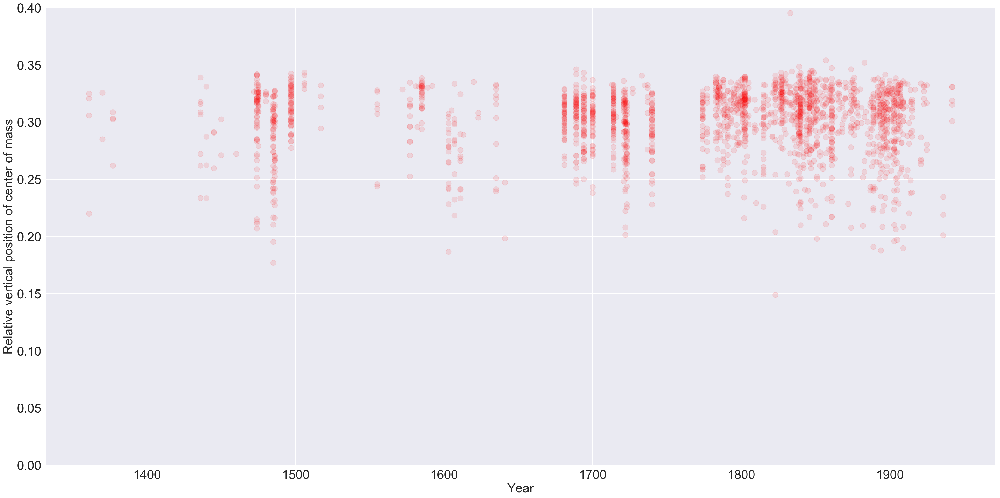

In [10]:
i = 3
scatter_and_lowess(df_fc_no_na, i, bootstrap_nbr=500, figsize=(30,15), trend_lines=False)
pltSaveToPng('ScatterPlotCoeff'+str(i), bonus_folder)

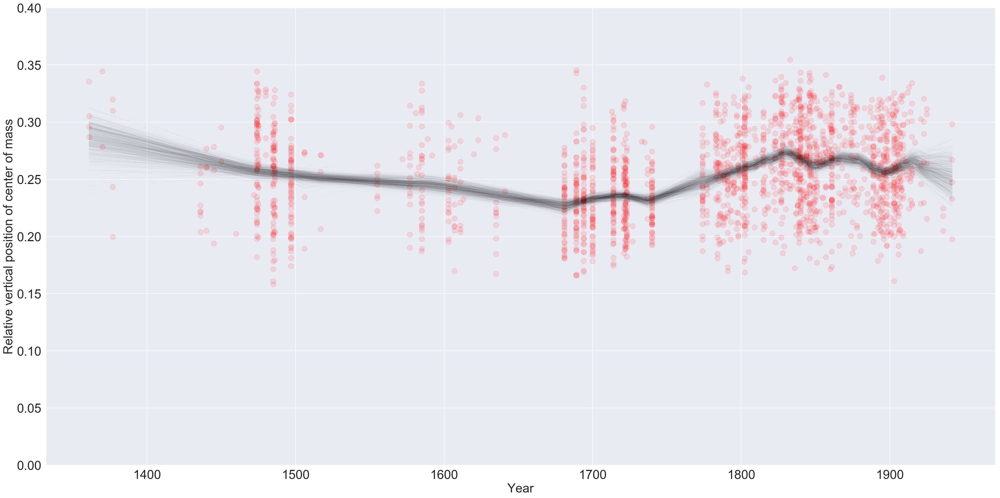

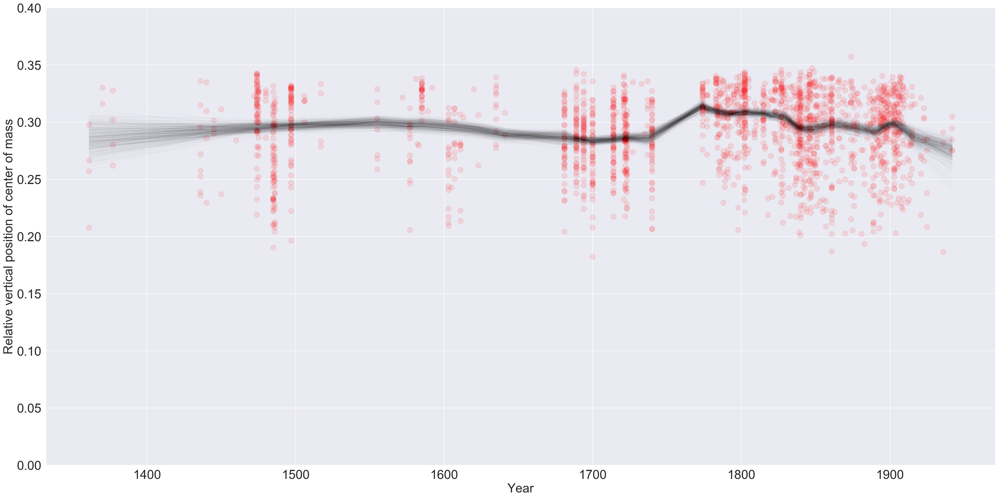

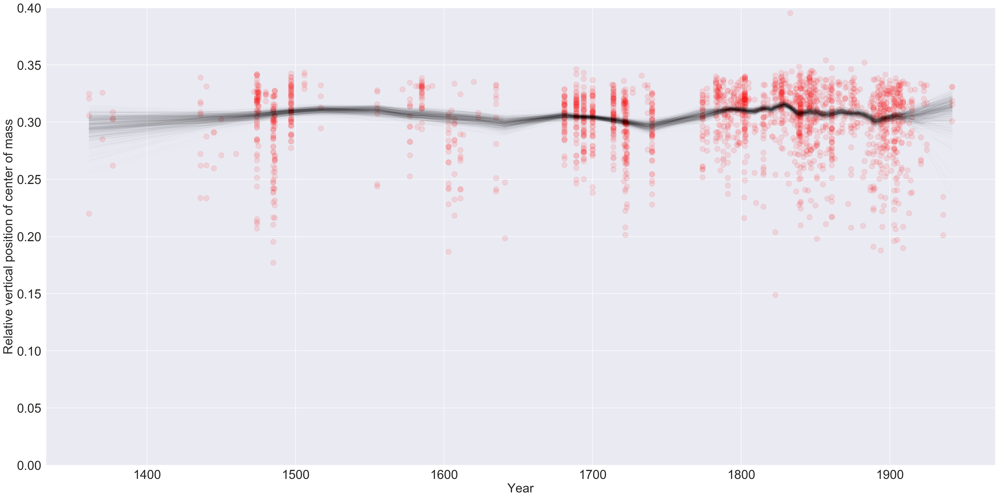

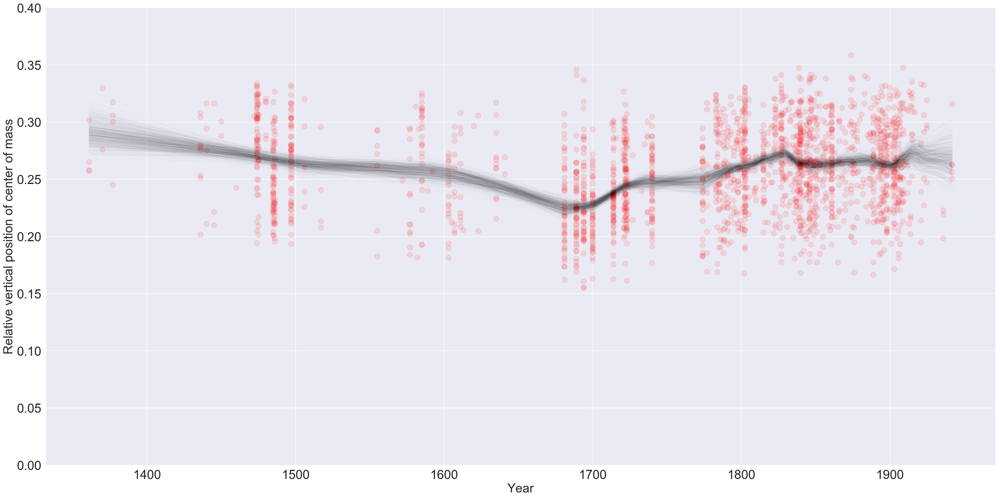

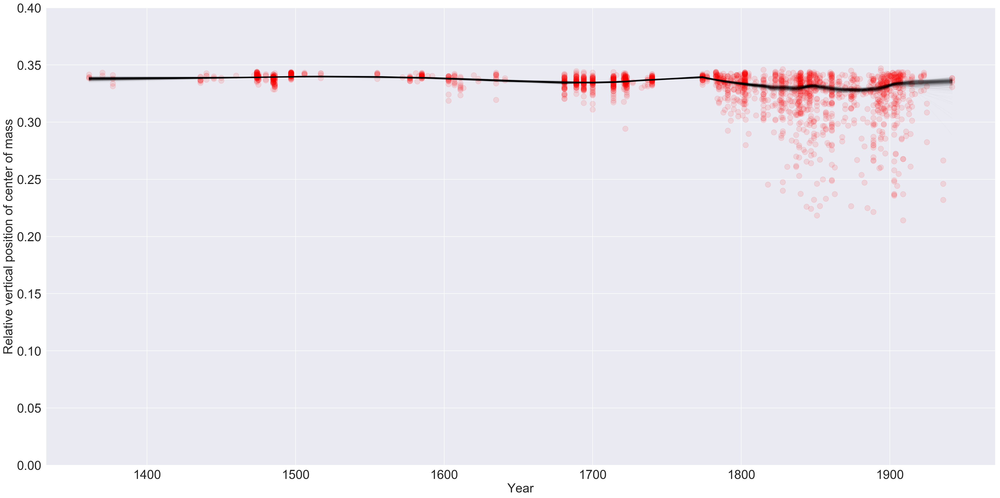

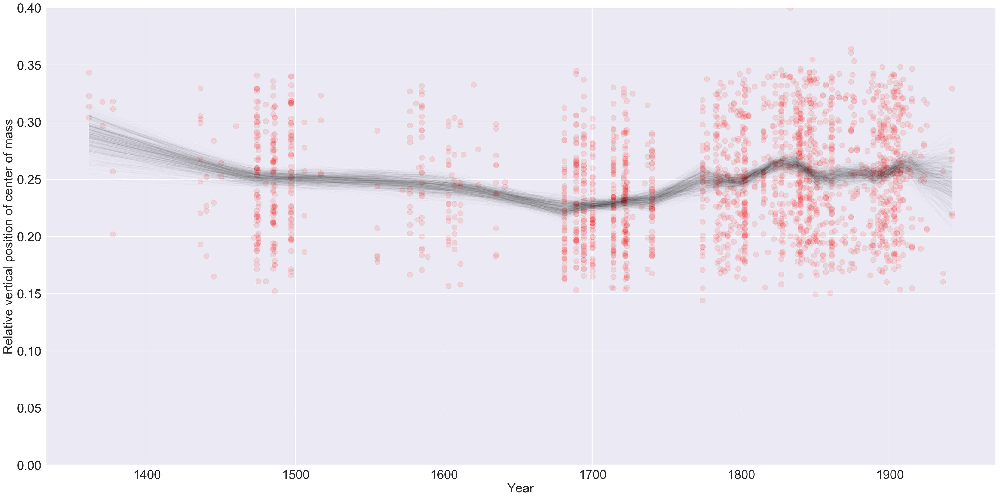

In [11]:
for i in range(1,7):
    scatter_and_lowess(df_fc_no_na, i, bootstrap_nbr=500, figsize=(30,15))
    plt.tight_layout()
    pltSaveToPng('TimeSeriesPlotCoeff'+str(i), bonus_folder)
    #plt.savefig(bonus_folder+'TimeSeriesPlotCoeff'+str(i)+'.eps')

In [42]:
chopin_prel = 'chopin-prelude-op28-2.mid'
wavescape_one_coeff(midi_files_folder+chopin_prel, big_resolution, 4, output_folder = bonus_folder, draw_indicators = False, draw_line = False)